Difference from neid_fiesta_daily.ipynb:
Weightd average in the uncertainties 

In [1]:
import sys
sys.path.append('../src')

import numpy as np
import matplotlib.pyplot as plt
from PyAstronomy import pyasl
from datetime import datetime

from FIESTA_functions import *
from HARPS_N_functions import *
from NEID_solar_functions import *
from functions import *
#----------------------------------
# Read data
#----------------------------------


In [45]:
if 1:
    v_grid  = np.loadtxt('../lib/data_v4/v_grid.txt')
    CCF     = np.loadtxt('../lib/data_v4/CCF.txt')
    σCCF   = np.loadtxt('../lib/data_v4/σCCF.txt')
    bjd     = np.loadtxt('../lib/data_v4/bjd.txt')
    rv      = np.loadtxt('../lib/data_v4/rv.txt')
    σrv     = np.loadtxt('../lib/data_v4/σrv.txt')
    idx_rej = np.array(np.loadtxt('../lib/data_v4/idx_rej'), dtype=bool)
    
    idx_v = (v_grid>89) & (v_grid<109)
    v_grid = v_grid[idx_v]
    
    CCF = CCF[:,~idx_rej]
    σCCF = σCCF[:,~idx_rej]
    CCF = CCF[idx_v,:]
    σCCF = σCCF[idx_v,:]    
    bjd = bjd[~idx_rej]
    rv = rv[~idx_rej]
    σrv = σrv[~idx_rej]

In [46]:
if 0:
    v_grid  = np.loadtxt('../lib/data_526_625/v_grid.txt')
    CCF     = np.loadtxt('../lib/data_526_625/CCF.txt')
    σCCF   = np.loadtxt('../lib/data_526_625/σ_CCF.txt')
    bjd     = np.loadtxt('../lib/data_526_625/bjd.txt')
    rv      = np.loadtxt('../lib/data_526_625/rv.txt')
    σrv     = np.loadtxt('../lib/data_526_625/σrv.txt')

    idx_t = (bjd<2459392) & (bjd>2459361)

    CCF = CCF[idx_v,idx_t]
    σCCF = σCCF[idx_v,idx_t]
    bjd = bjd[idx_t]
    rv = rv[idx_t]
    σrv = σrv[idx_t]


In [47]:
σCCF.shape, CCF.shape, v_grid.shape

((79, 31145), (79, 31145), (79,))

In [48]:
v_grid

array([ 89.25,  89.5 ,  89.75,  90.  ,  90.25,  90.5 ,  90.75,  91.  ,
        91.25,  91.5 ,  91.75,  92.  ,  92.25,  92.5 ,  92.75,  93.  ,
        93.25,  93.5 ,  93.75,  94.  ,  94.25,  94.5 ,  94.75,  95.  ,
        95.25,  95.5 ,  95.75,  96.  ,  96.25,  96.5 ,  96.75,  97.  ,
        97.25,  97.5 ,  97.75,  98.  ,  98.25,  98.5 ,  98.75,  99.  ,
        99.25,  99.5 ,  99.75, 100.  , 100.25, 100.5 , 100.75, 101.  ,
       101.25, 101.5 , 101.75, 102.  , 102.25, 102.5 , 102.75, 103.  ,
       103.25, 103.5 , 103.75, 104.  , 104.25, 104.5 , 104.75, 105.  ,
       105.25, 105.5 , 105.75, 106.  , 106.25, 106.5 , 106.75, 107.  ,
       107.25, 107.5 , 107.75, 108.  , 108.25, 108.5 , 108.75])

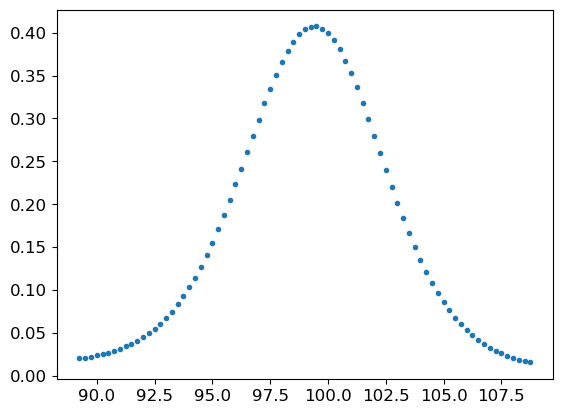

In [50]:
plt.plot(v_grid, CCF[:,0], '.')
plt.show()

### Daily averages

<ErrorbarContainer object of 3 artists>

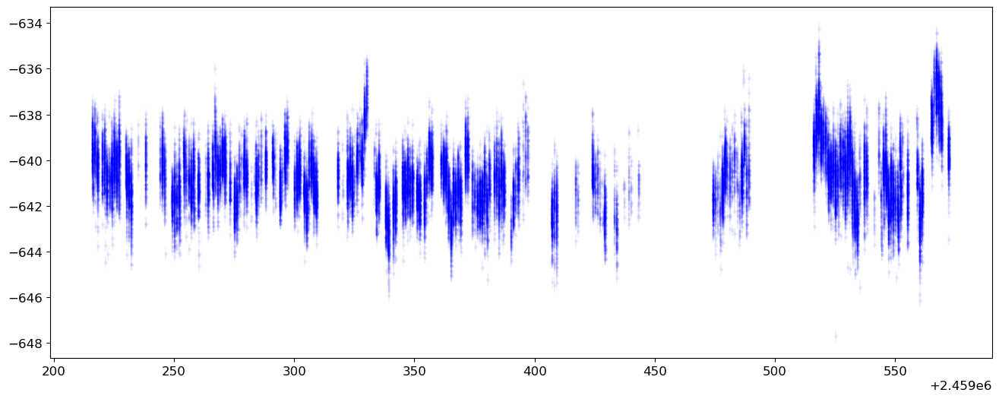

In [51]:
fig = plt.figure(figsize=(16, 6))
plt.errorbar(bjd, rv, σrv, marker='.', ms=5, color='blue', ls='none', alpha=0.05)

In [52]:
t_min = int(min(bjd))
t_max = int(max(bjd))
N = t_max -t_min + 1

bjd_daily 			= np.zeros(N)
CCF_daily 			= np.zeros((len(v_grid), N))
σCCF_daily			= np.zeros((len(v_grid), N))
rv_daily			= np.zeros(N)
# rv_raw_daily		= np.zeros(N)
σrv_daily			= np.zeros(N)

for n in range(N):
    idx = (bjd>(t_min+n)) & (bjd<(t_min+n+0.5))
    if len(bjd[idx])!=0:
        bjd_daily[n] = weighted_avg_1D(bjd[idx], 1/σrv[idx]**2)
        rv_daily[n] =  weighted_avg_1D(rv[idx], 1/σrv[idx]**2)
        σrv_daily[n] = 1/np.sqrt(np.sum(1/σrv[idx]**2))
        CCF_daily[:,n] = 1-weighted_avg_2D(1-CCF[:,idx], 1/σrv[idx]**2)
        σCCF_daily[:,n] = 1/np.sqrt(np.sum(1/σCCF[:,idx]**2, axis=1))

In [53]:
idx_0 		= (rv_daily==0)
rv_daily 	= rv_daily[~idx_0]
# rv_raw_daily= rv_raw_daily[~idx_0]
σrv_daily 	= σrv_daily[~idx_0]
bjd_daily 	= bjd_daily[~idx_0]
CCF_daily 	= CCF_daily[:,~idx_0]
σCCF_daily 	= σCCF_daily[:,~idx_0]

In [54]:
(bjd_daily-min(bjd_daily)).shape, v_grid.shape, CCF_daily.shape, (CCF_daily.T-np.mean(CCF_daily,axis=1)).T.shape

((202,), (79,), (79, 202), (79, 202))

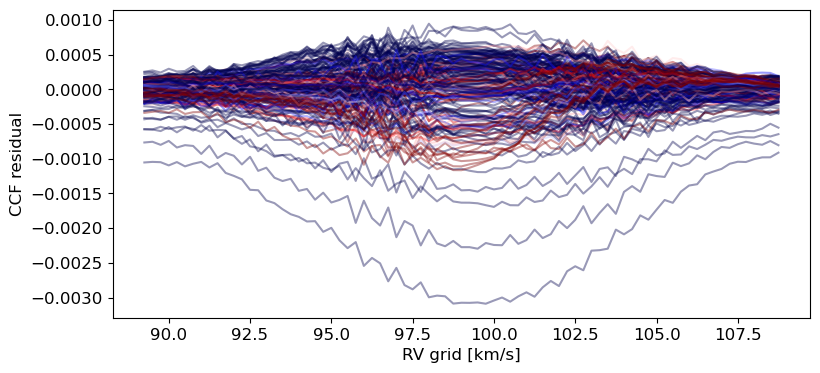

In [55]:
from matplotlib import colors
from matplotlib import cm

fig = plt.figure(figsize=(9, 4))
for i in range(CCF_daily.shape[1]):
    # plt.plot(v_grid, (CCF_daily.T-np.mean(CCF_daily,axis=1)).T[:,i], '-', c=cm.cool(((bjd_daily-min(bjd_daily))[i]+1)/(max(bjd_daily)-min(bjd_daily)+1)), alpha=0.5)
    plt.plot(v_grid, (CCF_daily.T-np.mean(CCF_daily,axis=1)).T[:,i], '-', c=cm.seismic((rv_daily-np.mean(rv_daily))[i]), alpha=0.4)    
plt.ylabel('CCF residual')
plt.xlabel('RV grid [km/s]')
plt.savefig('../Figures/CCF residual.png')
plt.show()

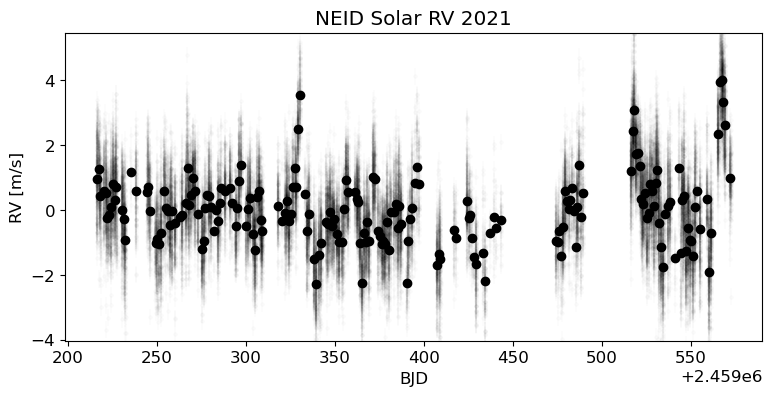

In [56]:
fig = plt.figure(figsize=(9, 4))
plt.errorbar(bjd, rv-np.mean(rv_daily), σrv, marker='.', ms=5, color='black', ls='none', alpha=0.01)
plt.errorbar(bjd_daily, rv_daily-np.mean(rv_daily), σrv_daily, marker='.', ms=12, color='black', ls='none')
plt.ylim([np.median(rv-np.mean(rv_daily))-4, np.median(rv-np.mean(rv_daily))+5.5])
plt.title('NEID Solar RV 2021')
plt.xlabel('BJD')
plt.ylabel('RV [m/s]')
plt.savefig('../Figures/NEID_solar_RV_2021.png')
plt.show()

In [57]:
weighted_avg_and_std(rv, 1/σrv**2), weighted_avg_and_std(rv_daily, 1/σrv_daily**2)

((-640.7388741816881, 1.4227938184859392),
 (-640.7388741816881, 1.099330039296157))

## FIESTA on daily CCF analysis

In [59]:
k_max = 39
df, RV_FT_k, eRV_FT_k, A_k, eA_k, RV_gauss = FIESTA(v_grid, CCF_daily, σCCF_daily, k_max=k_max)

order_max = k_max
RV_FIESTA = np.average(RV_FT_k[:order_max], axis=0, weights=A_k[:order_max])*1000
print(np.mean(A_k[order_max-1]))

RV_FT_k  *= 1000
eRV_FT_k *= 1000
RV_gauss *= 1000
ΔRV_k     = RV_FT_k - RV_FIESTA



Velocity grid used [89.25, 108.75]

ξ_normal = 1.97


The median SNR of all CCFs is 73594
ξ_modelling_noise = 1.97


Based on the user-defined SNR = 2.0:
ξ_individual = 1.97
ξ_timeseries = 1.72

In summary, the cut-off frequency for FIESTA is recommended to be 1.72 (34 frequency modes)

        ξ  individual_SNR  ts_SNR_A  ts_SNR_ϕ  modelling noise  \
0   0.000        195766.3     368.1       0.0          0.13608   
1   0.051        108910.7     115.8      37.6          0.03343   
2   0.101         27192.6      43.5      15.5          0.00563   
3   0.152          4573.5      16.5      10.2          0.00098   
4   0.203           626.7       5.8       7.2          0.00062   
5   0.253           226.6       4.4       5.0          0.00055   
6   0.304           215.9       3.8       3.9          0.00049   
7   0.354           168.7       3.6       3.2          0.00044   
8   0.405           142.8       3.7       3.0          0.00040   
9   0.456           122.3       2.9       2.7      

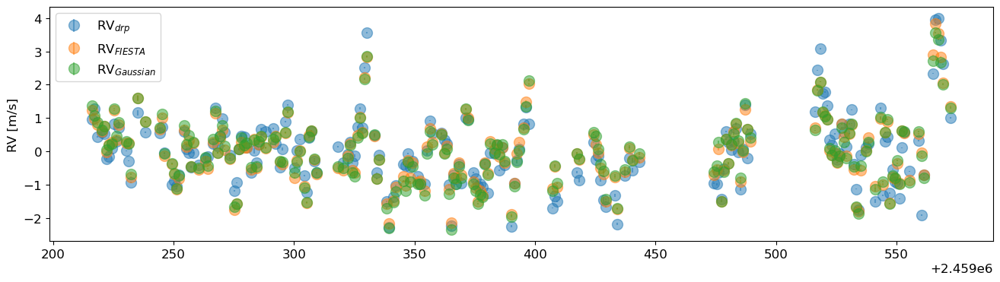

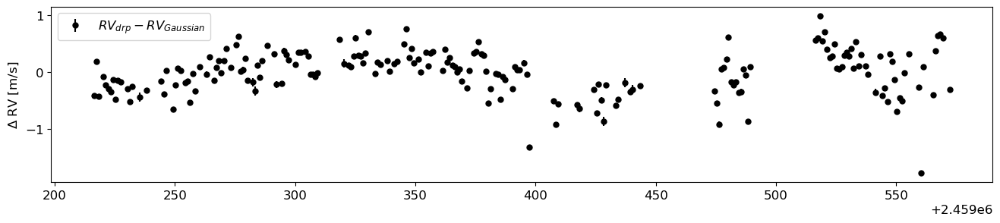

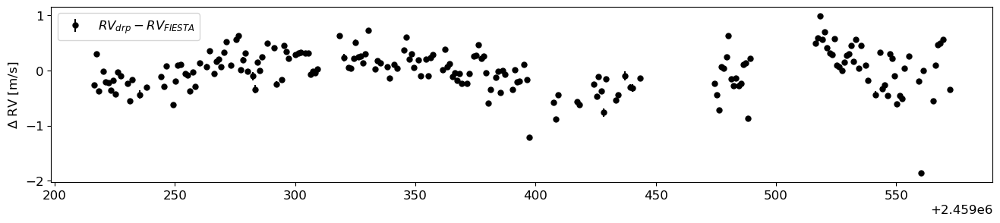

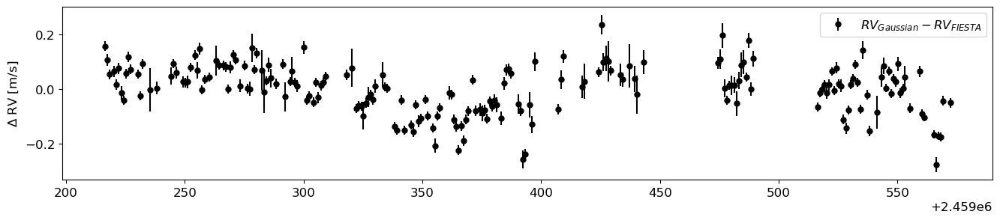

0.08522351117559428


In [60]:
fig = plt.figure(figsize=(16, 4))
plt.errorbar(bjd_daily, rv_daily-np.mean(rv_daily), σrv_daily, marker='o', ms=10, ls='none', label='RV$_{drp}$', alpha=0.5)
plt.errorbar(bjd_daily, RV_FIESTA-np.mean(RV_FIESTA), σrv_daily, marker='o', ms=10, ls='none', label='RV$_{FIESTA}$', alpha=0.5)
plt.errorbar(bjd_daily, RV_gauss-np.mean(RV_gauss), σrv_daily, marker='o', ms=10, ls='none', label='RV$_{Gaussian}$', alpha=0.5)
plt.ylabel('RV [m/s]')
plt.legend()
plt.show()

fig = plt.figure(figsize=(16, 3))
plt.errorbar(bjd_daily, rv_daily-RV_gauss-np.mean(rv_daily-RV_gauss), σrv_daily, marker='.', color='black', ms=10, ls='none', label='$RV_{drp} - RV_{Gaussian}$')
plt.legend()
plt.ylabel('$\Delta$ RV [m/s]')
plt.show()

fig = plt.figure(figsize=(16, 3))
plt.errorbar(bjd_daily, rv_daily-RV_FIESTA-np.mean(rv_daily-RV_FIESTA), σrv_daily, marker='.', color='black', ms=10, ls='none', label='$RV_{drp} - RV_{FIESTA}$')
plt.legend()
plt.ylabel('$\Delta$ RV [m/s]')
plt.show()

fig = plt.figure(figsize=(16, 3))
plt.errorbar(bjd_daily, RV_gauss-RV_FIESTA-np.mean(RV_gauss-RV_FIESTA), σrv_daily, marker='.', color='black', ms=10, ls='none', label='$RV_{Gaussian} - RV_{FIESTA}$')
plt.legend()
plt.ylabel('$\Delta$ RV [m/s]')
plt.show()

ave, wrms = weighted_avg_and_std(RV_gauss-RV_FIESTA, 1/σrv_daily**2)
print(wrms)

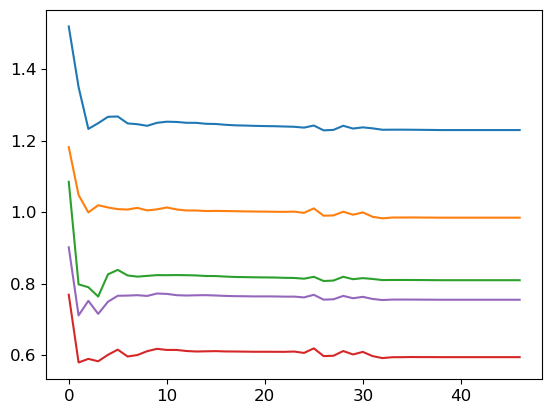

In [62]:
RV_FIESTA_array = np.zeros((47,202))
for order_max in range(47):
    RV_FIESTA_array[order_max] = np.average(RV_FT_k[:(order_max+1)], axis=0, weights=A_k[:(order_max+1)])
plt.plot(np.arange(47), RV_FIESTA_array[:,0:5])
# plt.axhline(y = RV_gauss[0], color = 'r', linestyle = '--')
plt.plot()
plt.show()

In [63]:
ΔRV_k.shape, RV_FT_k.shape, RV_gauss.shape

((39, 202), (39, 202), (202,))

In [64]:
np.median((1-CCF_daily) / σCCF_daily), np.median((1-CCF) / σCCF)

(73594.06000926348, 5869.123917431126)

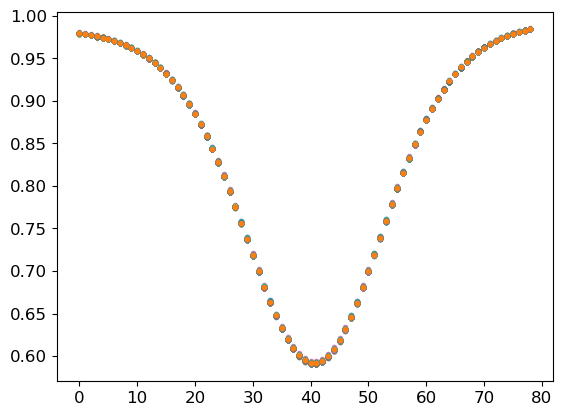

In [65]:
plt.plot(1-CCF_daily, '.')
# plt.plot(σCCF_daily)
plt.show()

In [23]:
# plt.plot(rv_daily-np.mean(rv_daily), np.average(RV_FT_k, weights=A_k, axis=0)-RV_gauss, '.')
# plt.show()
# plt.plot(rv_daily-np.mean(rv_daily), np.average(ΔRV_k, weights=A_k, axis=0), '.')
# plt.show()

In [24]:
np.savetxt('../lib/FIESTA_daily_output/RV_FT_k.txt', RV_FT_k)
np.savetxt('../lib/FIESTA_daily_output/eRV_FT_k.txt', eRV_FT_k)
np.savetxt('../lib/FIESTA_daily_output/ΔRV_k.txt', ΔRV_k)
np.savetxt('../lib/FIESTA_daily_output/bjd_daily.txt', bjd_daily)
np.savetxt('../lib/FIESTA_daily_output/rv_daily.txt', rv_daily)
np.savetxt('../lib/FIESTA_daily_output/RV_FIESTA.txt', RV_FIESTA)
np.savetxt('../lib/FIESTA_daily_output/σrv_daily.txt', σrv_daily)

In [46]:
RV_FT_k     = np.loadtxt('../lib/FIESTA_daily_output/RV_FT_k.txt')
eRV_FT_k    = np.loadtxt('../lib/FIESTA_daily_output/eRV_FT_k.txt')
ΔRV_k       = np.loadtxt('../lib/FIESTA_daily_output/ΔRV_k.txt')
bjd_daily   = np.loadtxt('../lib/FIESTA_daily_output/bjd_daily.txt')
rv_daily    = np.loadtxt('../lib/FIESTA_daily_output/rv_daily.txt')
σrv_daily   = np.loadtxt('../lib/FIESTA_daily_output/σrv_daily.txt')

### change the notation!

In [66]:
rv_daily = RV_FIESTA

In [67]:
A_k.shape[0]

39

## Plots 

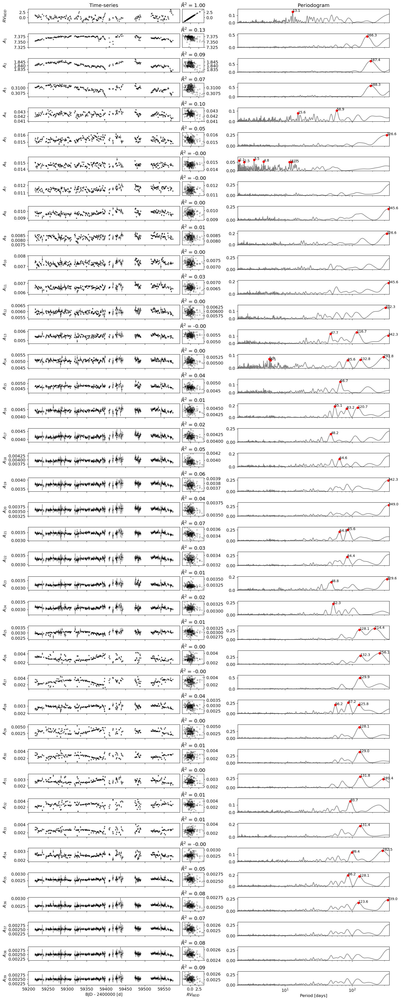

In [72]:
k_max = A_k.shape[0]

plot_all(k_mode=k_max, t=bjd_daily-2400000, rv=rv_daily, erv=σrv_daily*0.001, 
    ind=A_k, eind=eA_k, 
    ts_xlabel='BJD - 2400000 [d]', 
    rv_xlabel='$RV_{NEID}$', 
    pe_xlabel='Period [days]',
    ind_yalbel=r'$A$',
    file_name='',
    HARPS=False)
plt.show()



In [68]:
rv_daily.shape, σrv_daily.shape, ΔRV_k.shape

((202,), (202,), (39, 202))

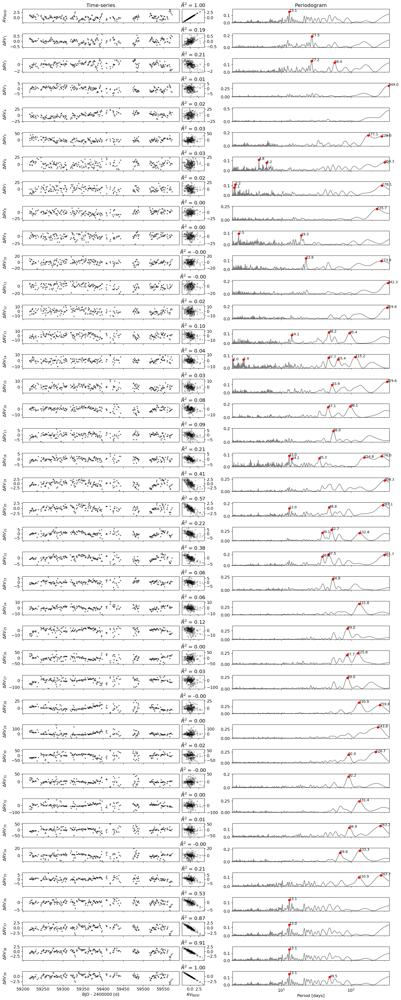

In [69]:
plot_all(k_mode=k_max, t=bjd_daily-2400000, rv=rv_daily, erv=σrv_daily, 
    ind=ΔRV_k, eind=eRV_FT_k*0.001, 
    ts_xlabel='BJD - 2400000 [d]', 
    rv_xlabel='$RV_{NEID}$', 
    pe_xlabel='Period [days]',
    ind_yalbel=r'$\Delta RV$',
    file_name='../Figures/ΔRV_k.png',
    HARPS=False)
plt.show()

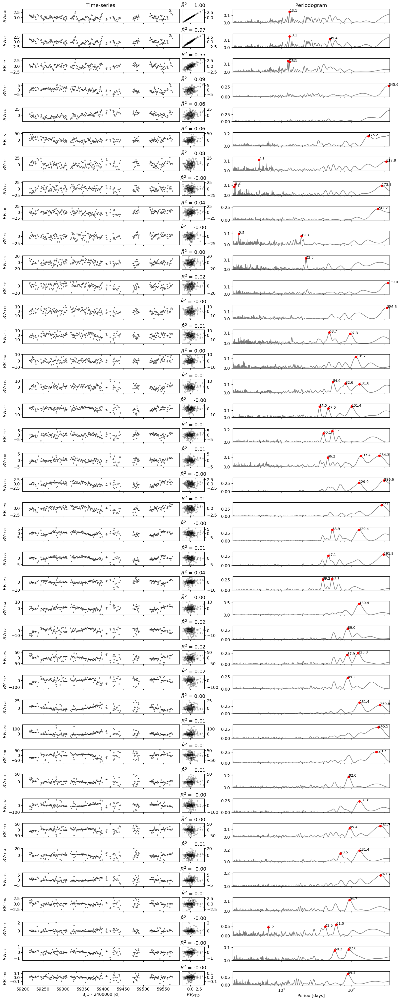

In [70]:
plot_all(k_mode=k_max, t=bjd_daily-2400000, rv=rv_daily, erv=σrv_daily, 
    ind=RV_FT_k, eind=eRV_FT_k*0.001, 
    ts_xlabel='BJD - 2400000 [d]', 
    rv_xlabel='$RV_{NEID}$', 
    pe_xlabel='Period [days]',
    ind_yalbel=r'$RV_{FT}$',
    file_name='',
    HARPS=False)
plt.show()

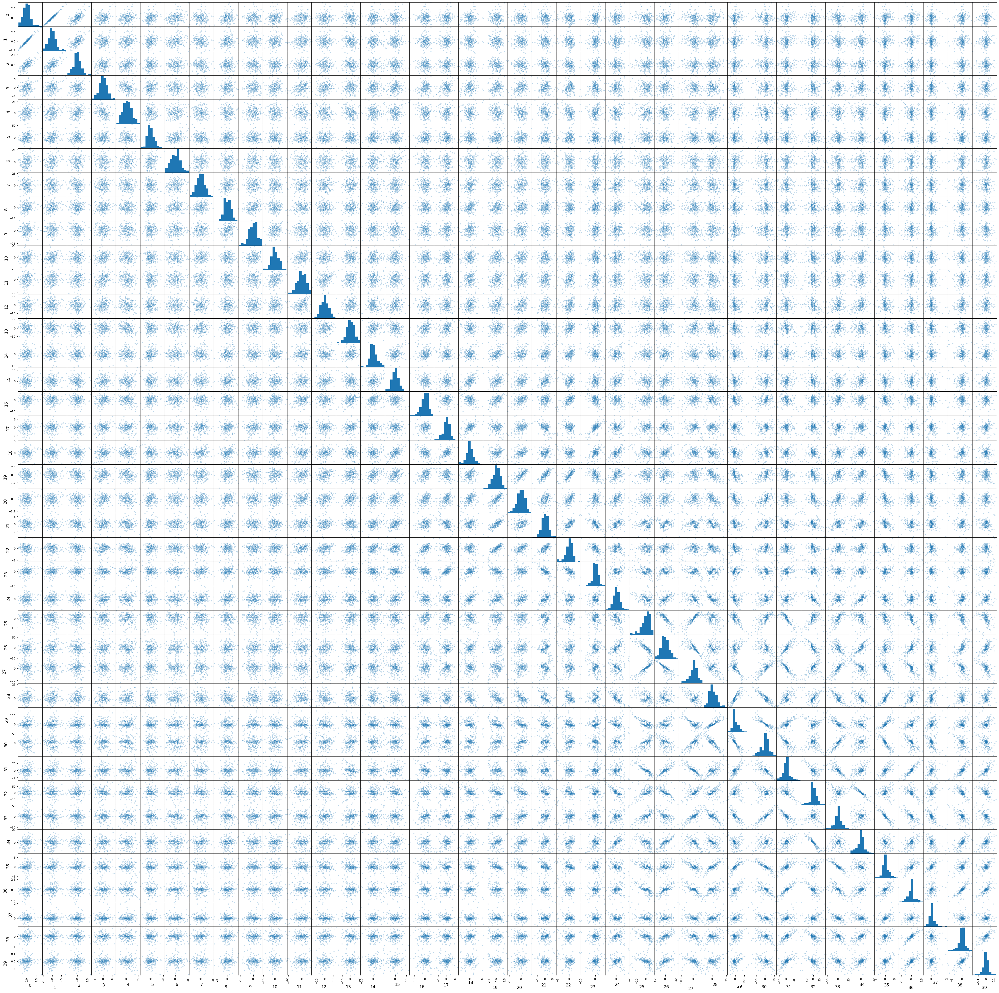

In [71]:
import pandas as pd
numpy_array = np.vstack((rv_daily, RV_FT_k)).T
df = pd.DataFrame(numpy_array)
pd.plotting.scatter_matrix(df, alpha=0.3, figsize=(50, 50))
# plt.savefig('../Figures/correlation_matrix_NEID.png')
plt.show()

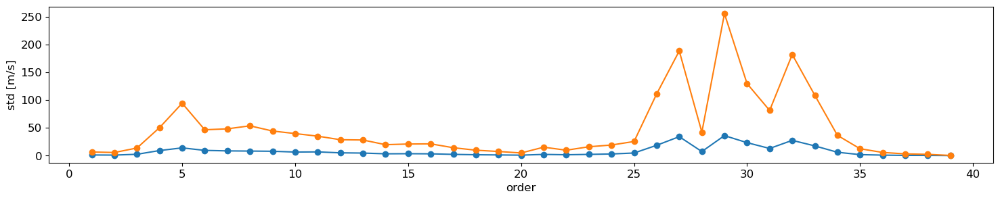

KeyError: 40

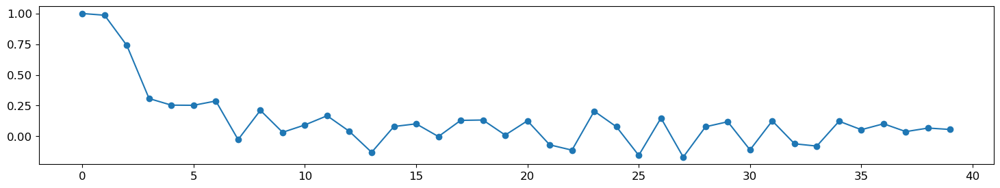

In [73]:
fig = plt.figure(figsize=(18, 3))
plt.plot(np.arange(k_max)+1, np.std(RV_FT_k, axis=1), 'o-')
plt.plot(np.arange(k_max)+1, (np.max(RV_FT_k, axis=1)-np.min(RV_FT_k, axis=1)), 'o-')
plt.xlabel('order')
plt.ylabel('std [m/s]')
plt.show()

fig = plt.figure(figsize=(18, 3))
plt.plot(np.arange(k_max+1), df.corr()[0], 'o-', label='correlation with RV')
plt.plot(np.arange(k_max)+1, np.array([df.corr()[i][i+1] for i in range(47)]), 'o-', label='correlation with previous order')
plt.axhline(y = 0, color = 'k', linestyle = '--')
plt.legend()
plt.show()

In [72]:
numpy_array = np.vstack((rv_daily, RV_FT_k)).T
df = pd.DataFrame(numpy_array)


In [92]:
df.corr()[1][2]

0.7574267296879573

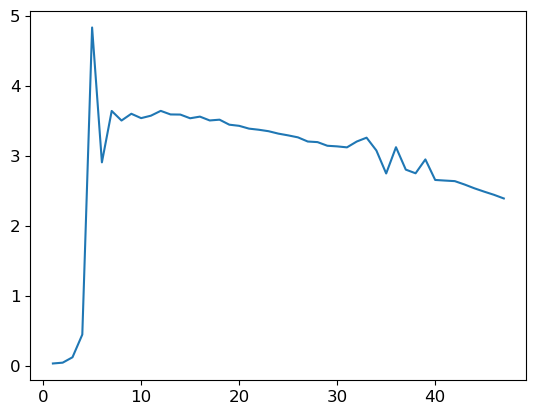

In [54]:
plt.plot(np.arange(47)+1, np.median(eRV_FT_k, axis=1))

# PCA

In [63]:
k_max = 47
PC, weighted_pca_score, err_weighted_pca_score, n_pca = weighted_pca(X=ΔRV_k[:k_max,:].T, X_err=eRV_FT_k[:k_max,:].T, nor=False)

Cumulative variance explained vs PCA components
1 	 44.206
2 	 61.858
3 	 77.911
4 	 82.338
5 	 86.273
6 	 89.251
7 	 91.666
8 	 93.685
9 	 95.150
10 	 96.414
11 	 97.417
12 	 98.181
13 	 98.888
14 	 99.397
15 	 99.880
16 	 100.233
17 	 100.560
18 	 100.801
19 	 100.997
20 	 101.164
21 	 101.274
22 	 101.361
23 	 101.413
24 	 101.448
25 	 101.476
26 	 101.492
27 	 101.502
28 	 101.509
29 	 101.515
30 	 101.519
31 	 101.523
32 	 101.526
33 	 101.529
34 	 101.531
35 	 101.532
36 	 101.534
37 	 101.534
38 	 101.535
39 	 101.535
40 	 101.535
41 	 101.535
42 	 101.535
43 	 101.535
44 	 101.533
45 	 101.394
46 	 101.129
47 	 100.000
7 pca scores account for 91.67% variance explained
Standard deviations of each component and the midean uncertainty are
 [61.6 35.  29.5 15.  14.  11.6 10.9] 
 [3.1 3.4 4.5 3.5 3.3 3.5 3.5]


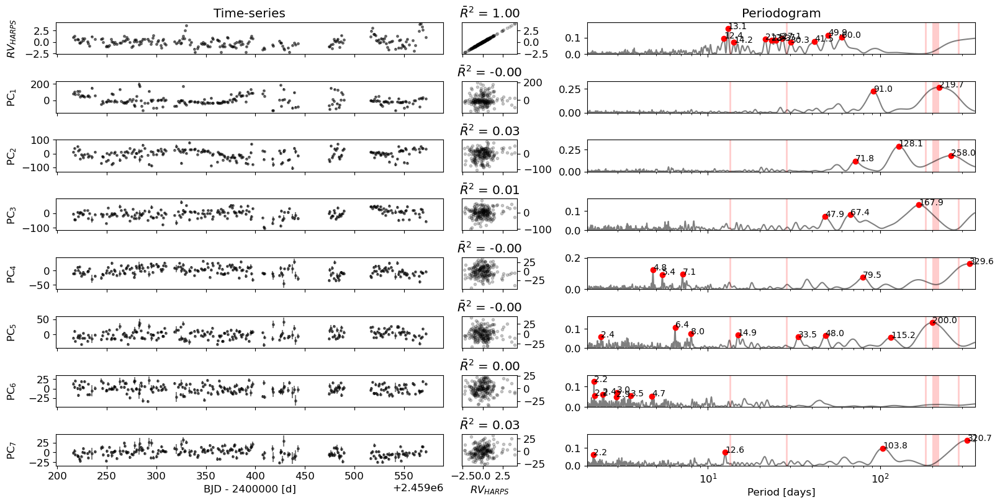

In [64]:
plot_all(k_mode=7, t=bjd_daily, rv=rv_daily, erv=σrv_daily, 
    vlines = [13.4, 28.5, 365/2, 285, 400],
    ind=weighted_pca_score.T, eind=err_weighted_pca_score.T, 
    ts_xlabel='BJD - 2400000 [d]', 
    rv_xlabel='$RV_{HARPS}$', 
    pe_xlabel='Period [days]',
    ind_yalbel='PC',
    height_ratio=0.4,
    file_name='')

# MLP

In [159]:
import tensorflow as tf
import keras
from keras import layers
from keras import models
from keras import utils
from keras.layers import Dense
from keras.models import Sequential
from keras.layers import Flatten
from keras.layers import Dropout
from keras.layers import Activation
from keras.regularizers import l2
from keras.optimizers import Adam
from keras.optimizers import RMSprop
from keras import datasets

from keras.callbacks import LearningRateScheduler
from keras.callbacks import History

from keras import losses
from sklearn.utils import shuffle

# print(tf.VERSION)
print(tf.keras.__version__)

2023-01-23 23:09:55.461522: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-01-23 23:09:56.237135: I tensorflow/core/util/util.cc:169] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-01-23 23:09:56.527752: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /storage/icds/RISE/sw8/julia-1.8.1/julia-1.8.1/lib:/storage/icds/RISE/sw8/anaconda/anaconda3/lib

2.10.0


In [160]:
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

def model_MLP(X, Y, bjd, σrv, lr_model, epochs=200, learning_rate=2e-4, kk=1):
# def model_MLP(X, Y, bjd, σrv, lr_model, epochs=200, learning_rate=2e-4):

 
    if 0:   
        scaler = StandardScaler()
        scaler.fit_transform(X)
    
    if 1: # random sample
        x_train, x_test, y_train, y_test, t_train, t_test, σrv_train, σrv_test = train_test_split(X, Y, bjd, σrv, test_size=0.3, random_state=random.randint(0, 10000))
    
    if 0: # consecutive sample
        kf = KFold(n_splits=4)
        i = 0
        for train_index, test_index in kf.split(X):
        # for test_index, train_index in kf.split(X): # note the shift between train_index and test_index (25% train and 75% test)
            i+=1
            if i==kk:
                t_train, y_train, σrv_train, x_train = bjd[train_index], Y[train_index], σrv[train_index], X[train_index]
                t_test, y_test, σrv_test, x_test = bjd[test_index], Y[test_index], σrv[test_index], X[test_index]

        print('x_train.shape', x_train.shape)
        print('x_test.shape', x_test.shape)
    
    batch_size= x_train.shape[0]

    ###################
    # hyperparameters #
    ###################
    # 1st to play with learning rate
    # 2nd batch size 
    # then epochs and activation functions 
    # batch_size = batch_size
    # epochs=epochs
    adam = Adam(learning_rate=learning_rate)

    if 0: # data type issue
        def custom_mse(y_test, y_pred):
            import keras.backend as K
            # calculating squared difference between target and predicted values 
            loss = K.square( (y_pred - y_test) / σrv_test)  # (batch_size, 2)                    
            # summing both loss values along batch dimension 
            loss = K.sum(loss, axis=1) / K.sum(K.square(1/σrv_test))        # (batch_size,)
            return loss

    if 1: # use this one 
        def custom_mse(y_test, y_pred):
            squared_difference = tf.dtypes.cast(tf.square((y_test - y_pred)/σrv_test), tf.float64) 
            return tf.dtypes.cast(tf.math.reduce_sum(squared_difference)/tf.math.reduce_sum(tf.square(1/σrv_test)), tf.float64)  # Note the `axis=-1`
    
    if 0:
        def custom_mse(y_test, y_pred):
            y_test = tf.dtypes.cast(y_test, tf.float64)
            y_pred = tf.dtypes.cast(y_pred, tf.float64)
            wrms = tf.dtypes.cast((tf.math.reduce_sum(tf.square((y_test - y_pred)/tf.dtypes.cast(σrv_test, tf.float64))) / tf.math.reduce_sum(tf.square(1/tf.dtypes.cast(σrv_test, tf.float64)))), tf.float64)
                                  # (tf.math.reduce_sum(tf.square((y_test - y_pred)/tf.dtypes.cast(σrv_test, tf.float64))) / tf.math.reduce_sum(tf.square(1/tf.dtypes.cast(σrv_test, tf.float64))))**0.5
            return wrms

    if 0: # data type issue
        def custom_mse(y_test, y_pred):
            weights=tf.square(1/tf.dtypes.cast(σrv_test, tf.float64))
            sum_weights = tf.reduce_sum(weights)
            resid = tf.reduce_sum(weights * tf.square(y_test - y_pred))
            return resid/sum_weights
        
    if 0: # this one does not work as the weights are by sample (requires two or more samples)
        def custom_mse(y_test, y_pred):
            mse = tf.keras.losses.MeanSquaredError()
            return mse(y_test, y_pred, sample_weight=tf.dtypes.cast((1/σrv_test)**2, tf.float64))
        


    # compile the model
    if 1:
        lr_model.compile(loss=custom_mse,
                      optimizer=adam,
                      metrics=[custom_mse])
    if 0:
        lr_model.compile(loss='mse',
                      optimizer=adam)    

    # from keras.callbacks import EarlyStopping
    # earlystop = EarlyStopping(monitor = 'val_mse',
    #                           min_delta = 0,
    #                           patience = 3,
    #                           verbose = 0,
    #                           restore_best_weights = True)

    # callback = tf.keras.callbacks.EarlyStopping(monitor='loss', patience=10)

    ### Fit the model
    lr_model_history = lr_model.fit(x_train, y_train,
                        batch_size=batch_size,
                        epochs=epochs,
                        verbose=0,
                        # callbacks = [callback],
                        validation_data=(x_test, y_test))
    
    y_pred = lr_model.predict(x_test)

    if 1:
        fig, ax = plt.subplots(1, 1)
        ax.plot(np.sqrt(lr_model_history.history['loss']), 'b', label='train')    
        ax.plot(np.sqrt(lr_model_history.history['val_loss']), 'r' ,label='test')
        ax.set_xlabel(r'Epoch')
        ax.set_ylabel(r'wmse')
        ax.set_yscale('log')
        ax.legend()
        ax.tick_params(labelsize=20)
        ax.grid()
        plt.show()

    # if 0:        
        plt.plot(t_test, y_test, 'r.', label='test')
        plt.plot(t_test, y_pred, 'k.', label='pred')
        plt.ylabel('RV [m/s]')
        plt.legend()
        plt.show()
        
    # if 0:
        plt.plot(y_test, y_pred, 'b.')
        plt.xlabel('test [m/s]')
        plt.ylabel('pred [m/s]')
        plt.show()    

    ave, std = weighted_avg_and_std(y_pred[:,0]-y_test, 1/σrv_test**2)
    print(std)
    
    return lr_model, y_test, y_pred[:,0], σrv_test, t_test, std
    

# use RV_FT_k as features and predict the shifted RV

add noise in the CCF level and repeat 
or do not repeat 

2/2 [==============================] - 0s 2ms/step


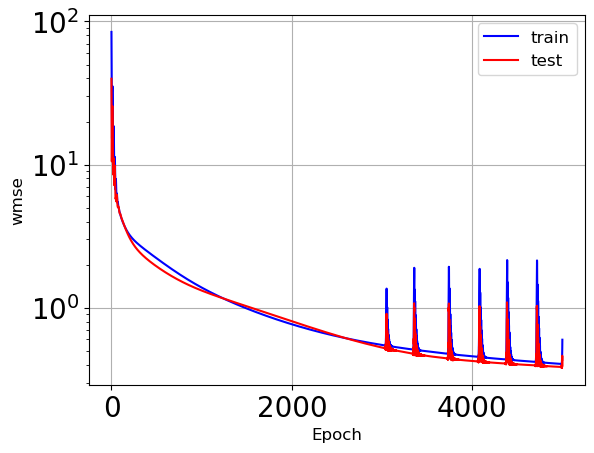

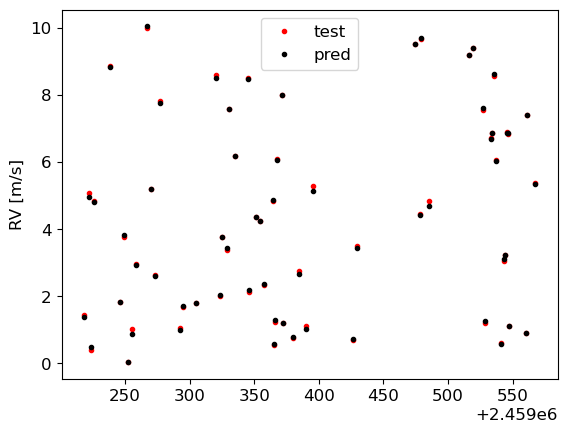

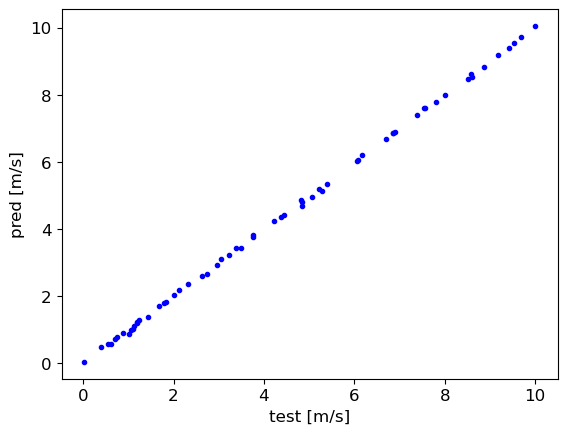

0.043656759016081785
2/2 [==============================] - 0s 3ms/step


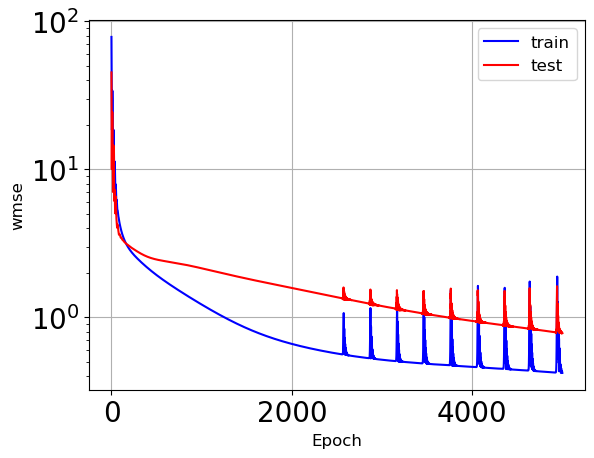

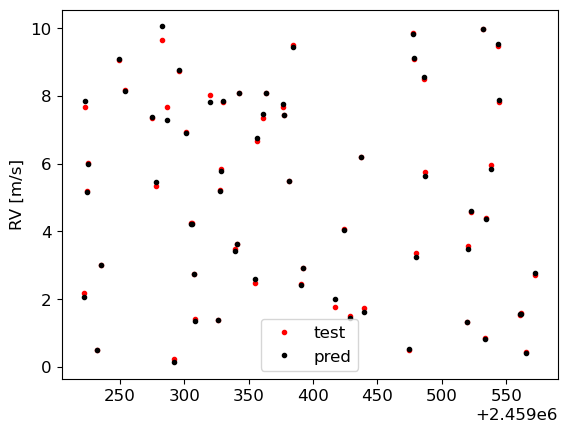

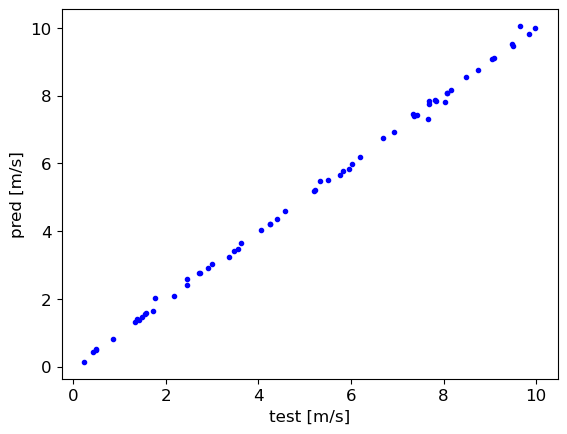

0.06130082479385542
2/2 [==============================] - 0s 3ms/step


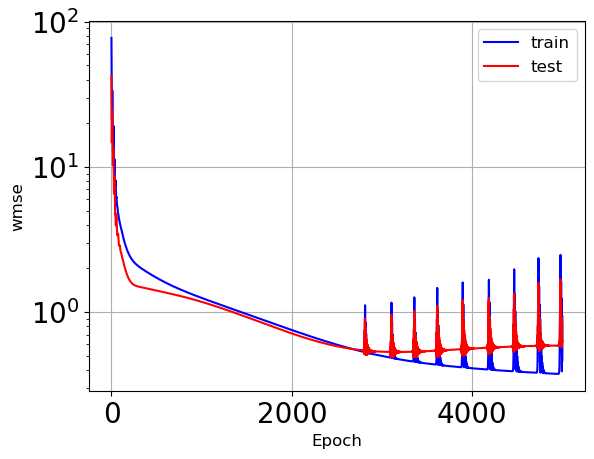

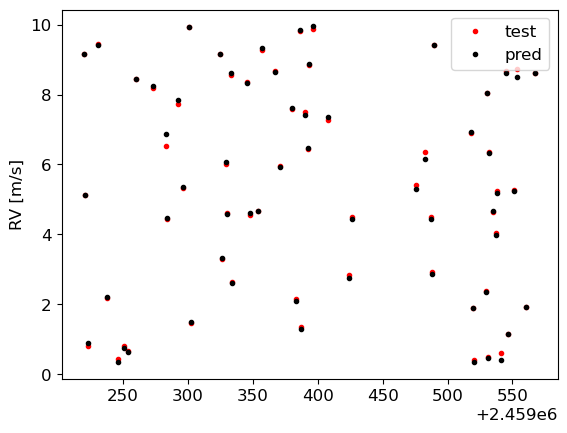

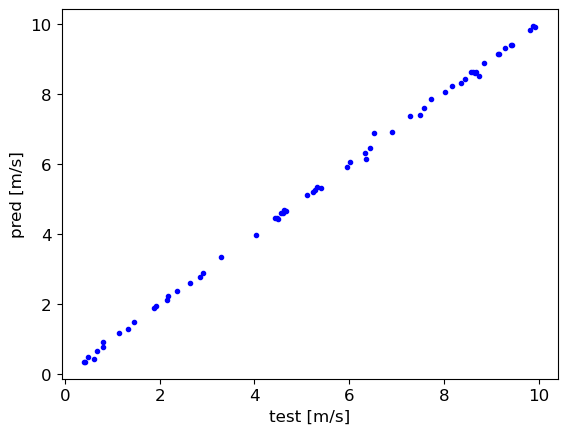

0.04556923237033922


2/2 [==============================] - 0s 1ms/step


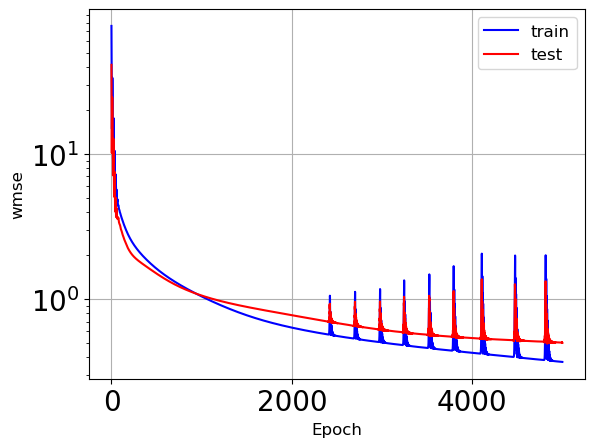

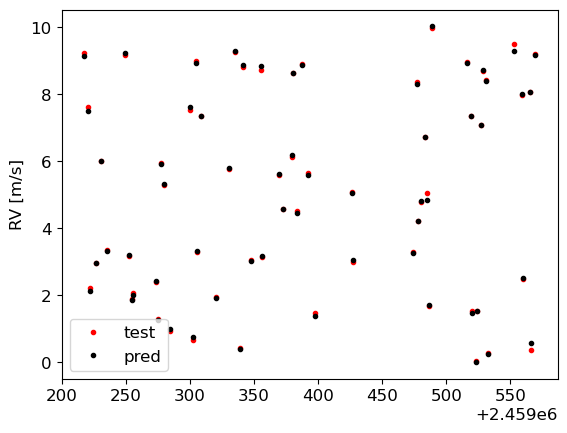

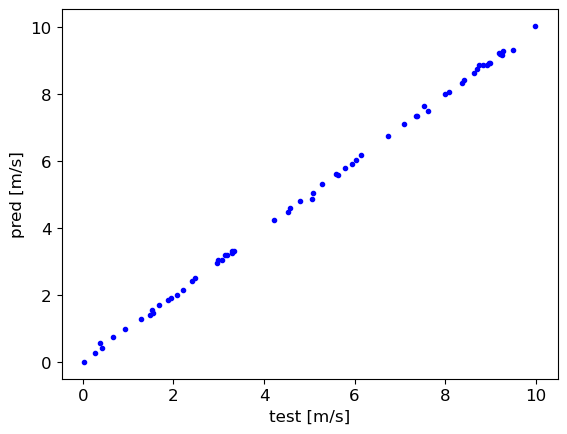

0.04984497886362059


2/2 [==============================] - 0s 1ms/step


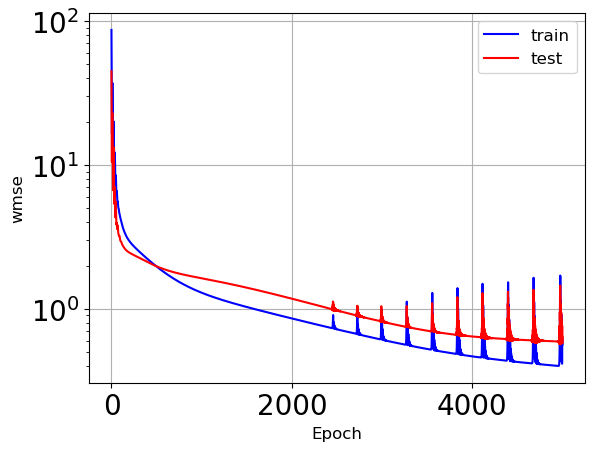

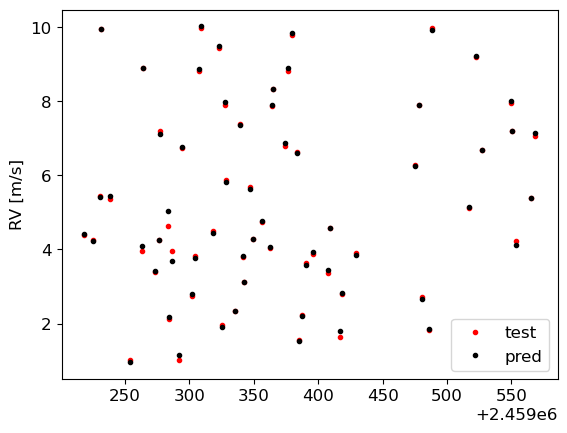

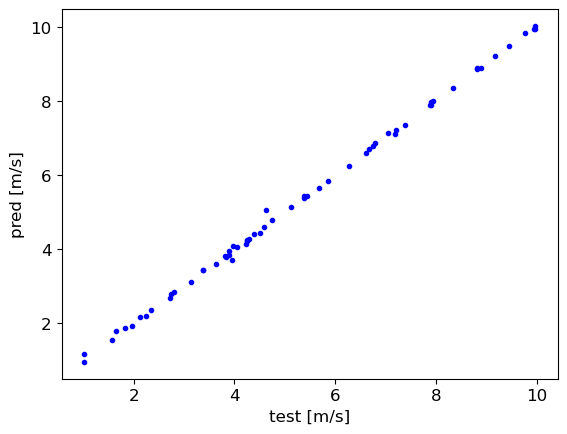

0.04736054284127251
2/2 [==============================] - 6s 3ms/step


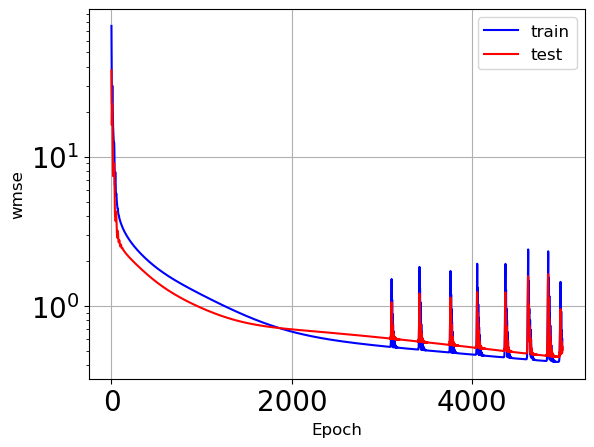

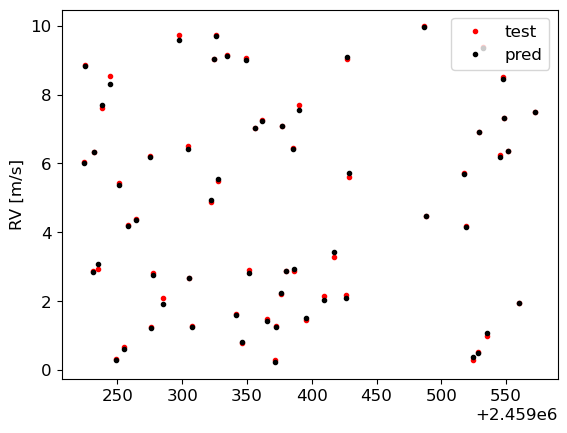

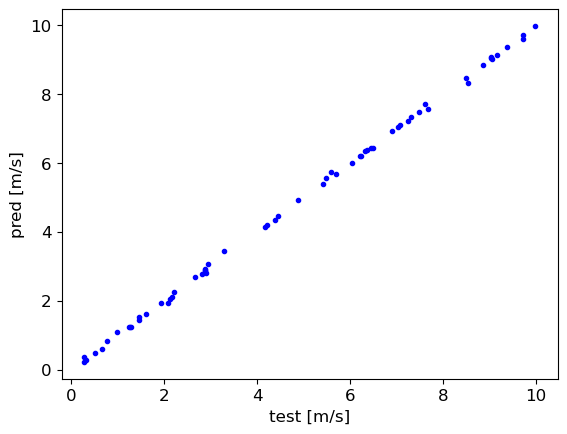

0.04664737066640766
2/2 [==============================] - 0s 2ms/step


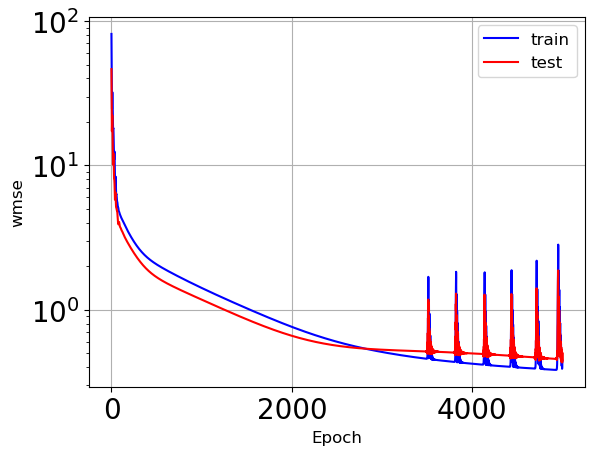

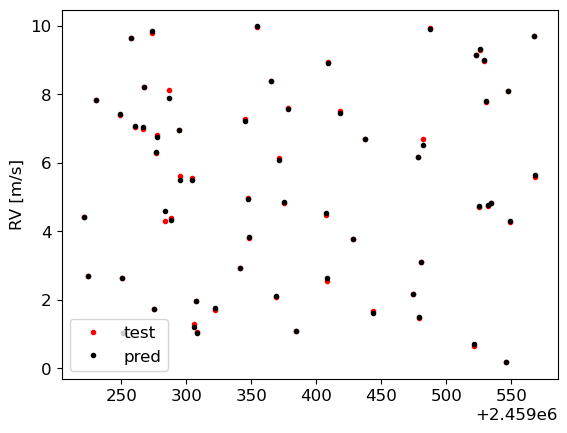

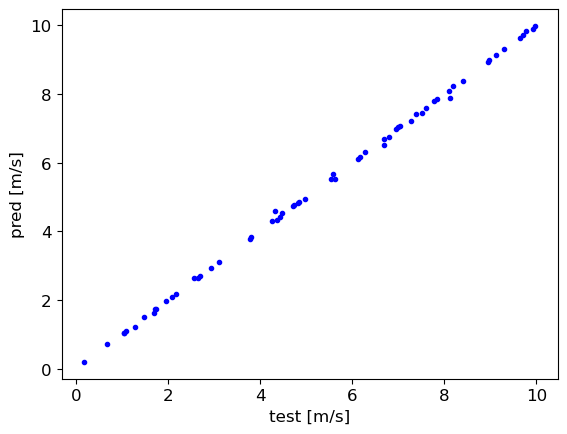

0.03893949476363265
2/2 [==============================] - 0s 2ms/step


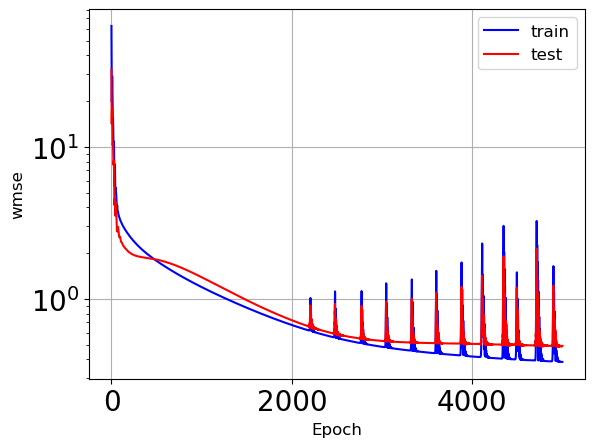

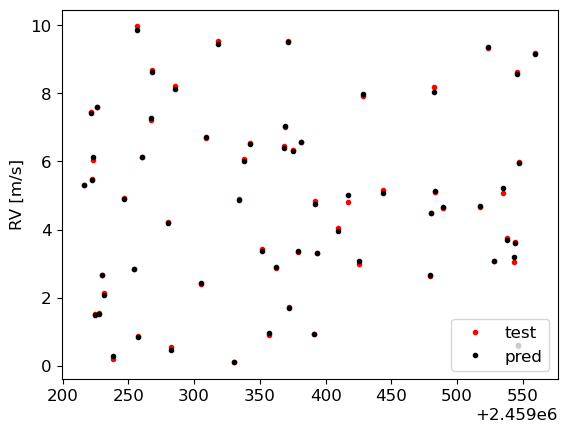

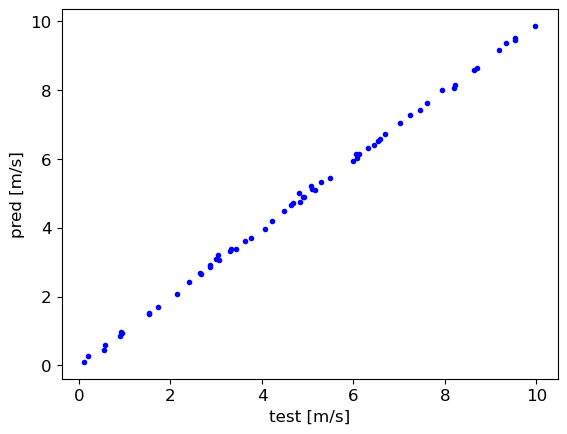

0.0466165373748052
2/2 [==============================] - 0s 2ms/step


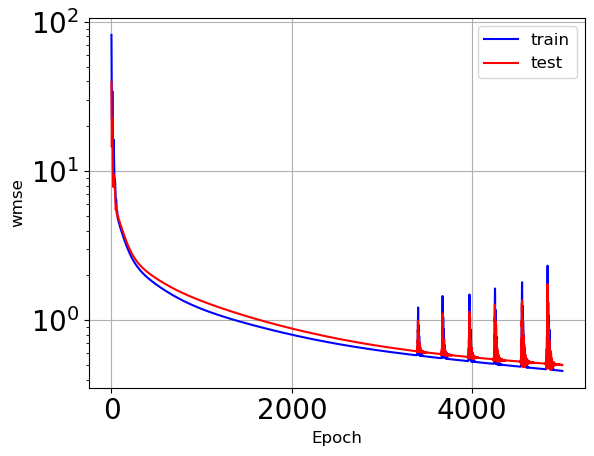

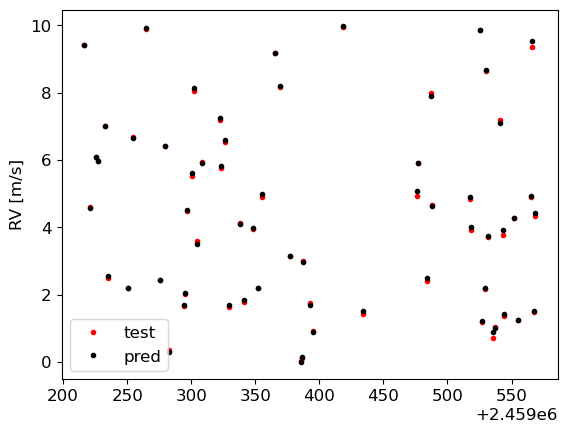

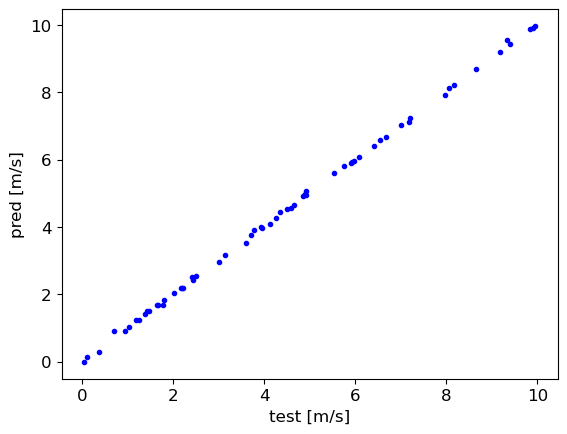

0.046476604912540964
2/2 [==============================] - 0s 2ms/step


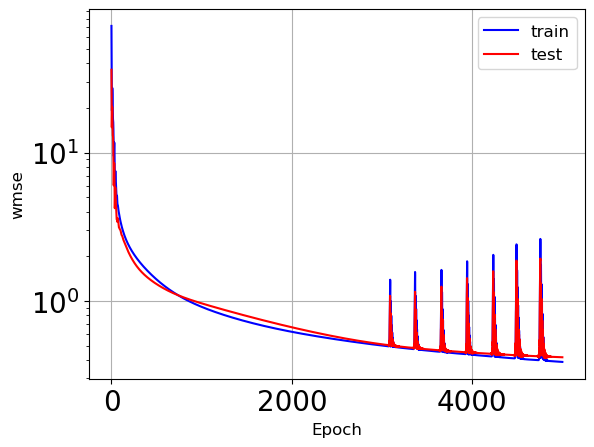

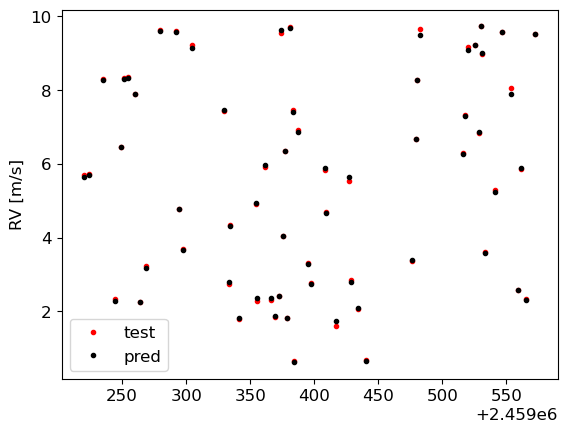

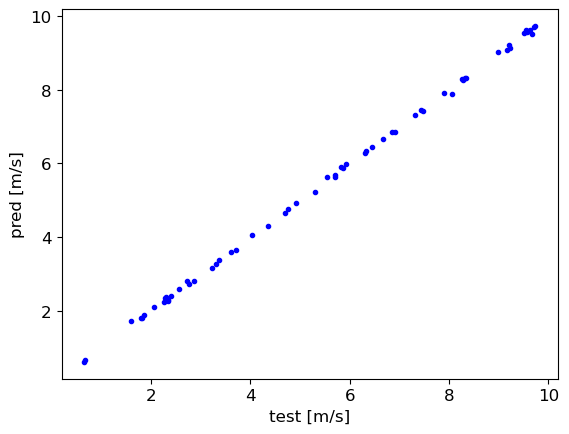

0.03936947475622215


In [69]:
# Add ramdom RV shift 
run = 10
weights = np.zeros((run, RV_FT_k.shape[0]))
for i in range(run):
    random_rv_shift = np.random.rand(len(rv_daily))*10

    X = (RV_FT_k+random_rv_shift).T
    Y = random_rv_shift

    ###################
    # build the model #
    ###################
    input_dim = X.shape[1]
    lr_model = Sequential()
    lr_model.add(Dense(1, kernel_initializer='uniform', activation=tf.keras.activations.linear))
    lr_model, y_test, y_pred, σrv_test, bjd_test, std  = model_MLP(X, Y, bjd_daily, σrv_daily, lr_model, epochs=5000, learning_rate=5e-3)
    weights[i,:] = lr_model.get_weights()[0].flatten()
    

2023-01-16 21:43:18.155458: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /storage/icds/RISE/sw8/julia-1.8.1/julia-1.8.1/lib:/storage/icds/RISE/sw8/anaconda/anaconda3/lib
2023-01-16 21:43:18.156580: W tensorflow/stream_executor/cuda/cuda_driver.cc:263] failed call to cuInit: UNKNOWN ERROR (303)
2023-01-16 21:43:18.156598: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (p-sc-2002): /proc/driver/nvidia/version does not exist
2023-01-16 21:43:18.160396: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the approp

2/2 [==============================] - 0s 2ms/step


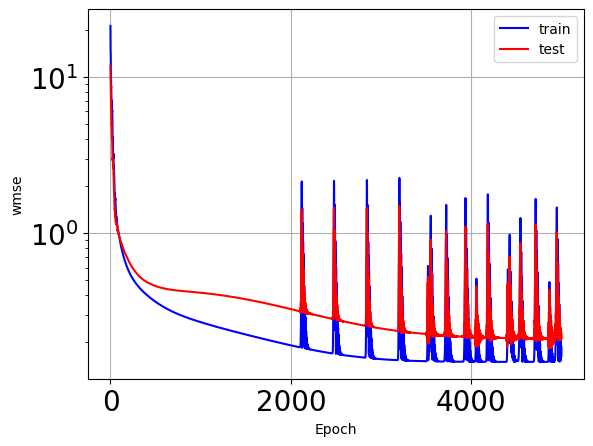

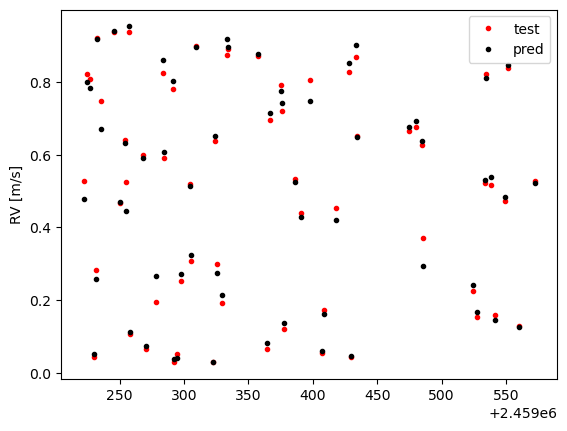

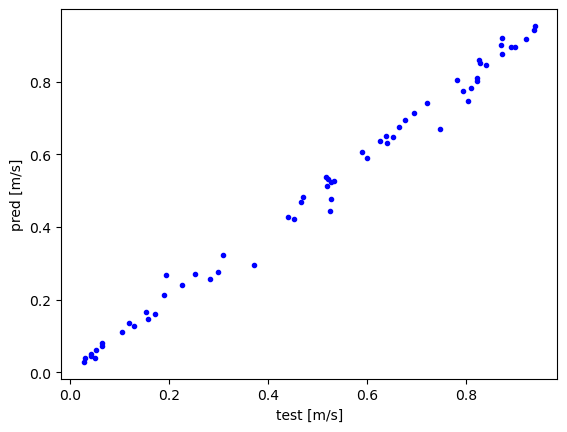

0.018253409990726423


In [68]:
random_rv_shift = np.random.rand(len(rv_daily))*1
X = (RV_FT_k+random_rv_shift).T
Y = random_rv_shift
###################
# build the model #
###################
lr_model = Sequential()
lr_model.add(Dense(1, kernel_initializer='uniform', activation=tf.keras.activations.linear))
lr_model_history, y_test, y_pred, σrv_test, bjd_test, std  = model_MLP(X, Y, bjd_daily, σrv_daily, lr_model, epochs=5000, learning_rate=5e-3)


### multilinear regression only 

Part 1

In [69]:
RV_planet = 0.03*np.sin(bjd_daily)
X = (RV_FT_k + RV_planet).T
Y = rv_daily + RV_planet

rms = 0.24424955797872525
0.023725282471295368


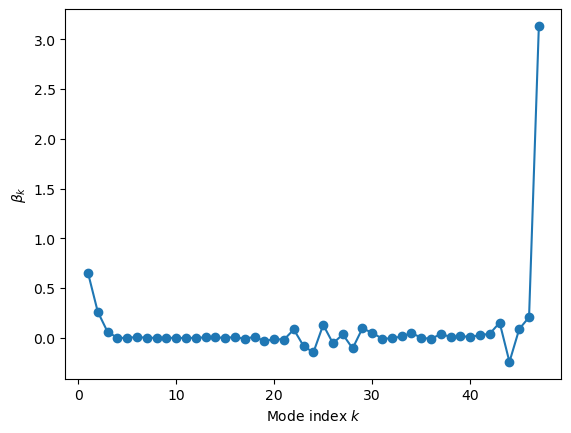

In [70]:
def loss(params):
    diff = np.sum(params[:47]* (X.T-params[48]*np.sin(bjd_daily)).T, axis=1) + params[47] - (Y-params[48]*np.sin(bjd_daily))
    _, wrms = weighted_avg_and_std(diff, 1/σrv_daily**2)
    return wrms

initial_guess = np.zeros(49)
# result = optimize.minimize(loss, initial_guess, method='L-BFGS-B')
result = optimize.minimize(loss, initial_guess)

# if result.success:
fitted_params = result.x
print('rms =', loss(fitted_params))
# else:
#     raise ValueError(result.message)    

plt.plot(np.arange(47)+1, fitted_params[:47], 'o-')     
plt.xlabel('Mode index $k$')
plt.ylabel(r'$\beta_k$')

print(fitted_params[48])

part 2

In [71]:
random_rv_shift_1 = np.random.rand(101)
random_rv_shift_2 = (np.random.rand(101)-0.5)*10

X[:101] = (RV_FT_k[:,:101]+random_rv_shift_1).T
X[101:] = (RV_FT_k[:,101:]+random_rv_shift_2).T
Y = random_rv_shift_1

rms = 0.026712772716770732


Text(0, 0.5, '$\\beta_k$')

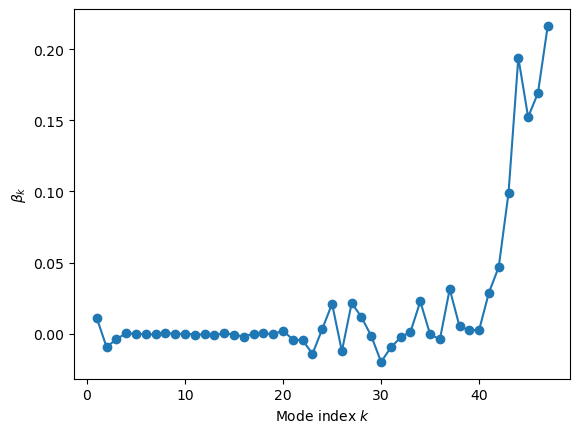

In [72]:
from scipy import optimize

def loss(params):
    diff = np.sum(params[:47]*X[:101], axis=1) + params[47] - Y[:101]
    _, wrms = weighted_avg_and_std(diff, 1/σrv_daily[:101]**2)
    return wrms
    
initial_guess = np.zeros(48)
result = optimize.minimize(loss, initial_guess, method='L-BFGS-B')

# if result.success:
fitted_params = result.x
print('rms =', loss(fitted_params))
# else:
#     raise ValueError(result.message)    

plt.plot(np.arange(47)+1, fitted_params[:47], 'o-')     
plt.xlabel('Mode index $k$')
plt.ylabel(r'$\beta_k$')

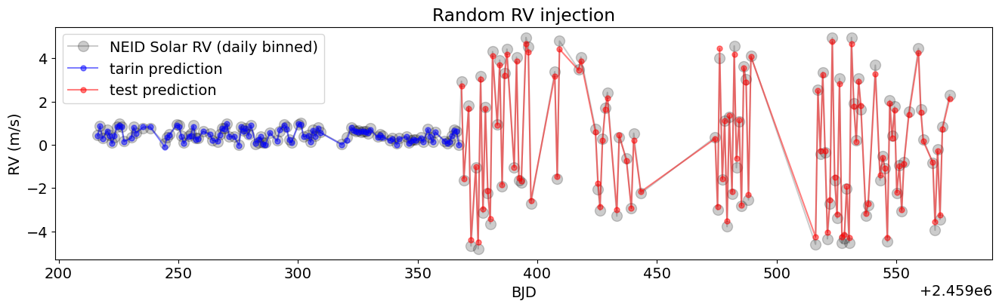

In [236]:
y_pred = np.sum(fitted_params[:47]*X[101:], axis=1) + fitted_params[47]
y_pred_train = np.sum(fitted_params[:47]*X[:101], axis=1) + fitted_params[47]

plt.rcParams['font.size'] = '14'
fig = plt.figure(figsize=(16, 4))

# plt.errorbar(bjd, rv-np.mean(rv_daily), σrv, marker='.', ms=5, color='black', ls='none', alpha=0.005)
plt.plot(bjd_daily, np.hstack((random_rv_shift_1, random_rv_shift_2)), marker='.', ms=20, color='black', ls='-', alpha=0.2, label='NEID Solar RV (daily binned)')
plt.plot(bjd_daily[:101], y_pred_train, marker='.', ms=10, color='blue', ls='-', alpha=0.5, label='tarin prediction')
plt.plot(bjd_daily[101:], y_pred, marker='.', ms=10, color='red', ls='-', alpha=0.5, label='test prediction')
# plt.ylim([np.median(rv-np.mean(rv_daily))-4, np.median(rv-np.mean(rv_daily))+5])
plt.title('Random RV injection')
plt.xlabel('BJD')
plt.ylabel('RV (m/s)')
plt.legend(loc=2)
# plt.savefig('../Figures/Postdoc application/NEID Solar RV (Year 2021) and FIESTA prediction.png')
plt.show()

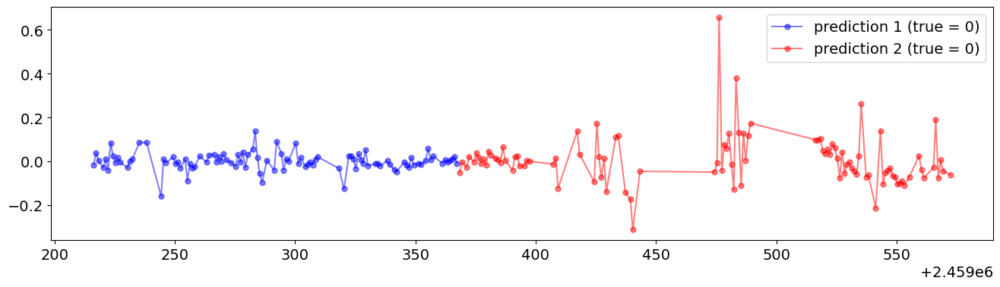

In [237]:
plt.rcParams['font.size'] = '14'
fig = plt.figure(figsize=(16, 4))
y1 = np.sum(fitted_params[:47]*RV_FT_k[:,:101].T, axis=1) + fitted_params[47]
y2 = np.sum(fitted_params[:47]*RV_FT_k[:,101:].T, axis=1) + fitted_params[47]
plt.plot(bjd_daily[:101], y1, marker='.', ms=10, color='blue', ls='-', alpha=0.5, label='prediction 1 (true = 0)')
plt.plot(bjd_daily[101:], y2, marker='.', ms=10, color='red', ls='-', alpha=0.5, label='prediction 2 (true = 0)')
plt.legend()
plt.show()

### Train-test-split: loop over the time-sereis 

1


ValueError: x and y must have same first dimension, but have shapes (47,) and (181, 47)

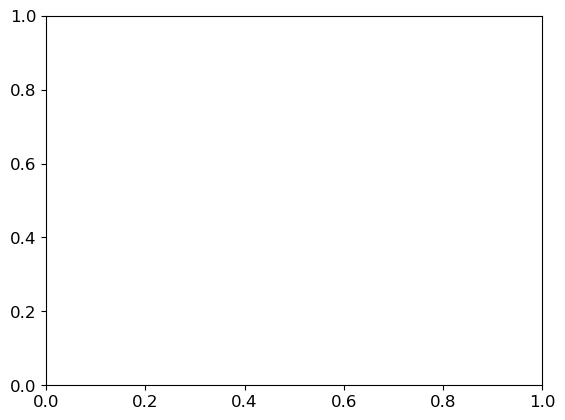

In [93]:
random_rv_shift = (np.random.rand(len(rv_daily))-0.5)*10
X = (RV_FT_k+random_rv_shift).T
Y = random_rv_shift

wrms_train = np.zeros(10)
wrms_test = np.zeros(10)
wrms_all = np.zeros(10)

for kk in range(11):
    kf = KFold(n_splits=10)
    i = 0
    for train_index, test_index in kf.split(X):
        i+=1
        if i==kk:
            print (i)
            t_train, y_train, σrv_train, x_train = bjd_daily[train_index], Y[train_index], σrv_daily[train_index], X[train_index]
            t_test, y_test, σrv_test, x_test = bjd_daily[test_index], Y[test_index], σrv_daily[test_index], X[test_index]

            def loss(params):
                diff = np.sum(params[:47]*x_train, axis=1) + params[47] - y_train
                _, wrms = weighted_avg_and_std(diff, 1/σrv_train**2)
                return wrms

            initial_guess = np.zeros(48)
            result = optimize.minimize(loss, initial_guess, method='L-BFGS-B')

            fitted_params = result.x
            
            plt.plot(np.arange(47)+1, fitted_params[:47]*x_train + fitted_params[47], 'o-')     
            plt.xlabel('Mode index $k$')
            plt.ylabel(r'$\beta_k$')            
            plt.show()
            
            y_pred = np.sum(fitted_params[:47]*x_test, axis=1) + fitted_params[47]
            y_pred_train = np.sum(fitted_params[:47]*x_train, axis=1) + fitted_params[47]
            fig = plt.figure(figsize=(16, 4))
            plt.plot(bjd_daily, random_rv_shift, marker='.', ms=20, color='black', ls='-', alpha=0.2, label='NEID Solar RV (daily binned)')
            plt.plot(t_train, y_pred_train, marker='.', ms=10, color='blue', ls='-', alpha=0.5, label='tarin prediction')
            plt.plot(t_test, y_pred, marker='.', ms=10, color='red', ls='-', alpha=0.5, label='test prediction')
            # plt.ylim([np.median(rv-np.mean(rv_daily))-4, np.median(rv-np.mean(rv_daily))+5])
            plt.title('Random RV injection')
            plt.xlabel('BJD')
            plt.ylabel('RV (m/s)')
            plt.legend(loc=2)
            # plt.savefig('../Figures/Postdoc application/NEID Solar RV (Year 2021) and FIESTA prediction.png')
            plt.show()        
    
            _, wrms_train[i-1] = weighted_avg_and_std(y_pred_train-y_train, 1/σrv_train**2)
            _, wrms_test[i-1] = weighted_avg_and_std(y_pred-y_test, 1/σrv_test**2)

            y_pred_all = np.sum(fitted_params[:47]*RV_FT_k.T, axis=1) + fitted_params[47]
            _, wrms_all[i-1] = weighted_avg_and_std(y_pred_all, 1/σrv_daily**2)
    

In [165]:
params[:47]*x_train

NameError: name 'params' is not defined

In [164]:
x_train.shape

(181, 47)

In [122]:

wrms_train

array([0.04206365, 0.0457843 , 0.0392904 , 0.04345632, 0.04397531,
       0.0445431 , 0.04084828, 0.04228009, 0.04388247, 0.04393779])

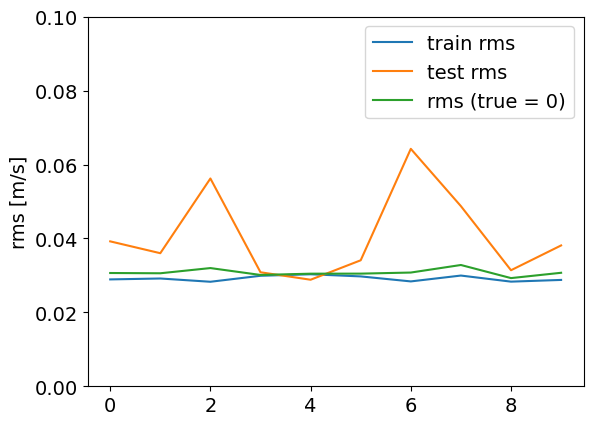

In [155]:
plt.plot(wrms_train, label='train rms')
plt.plot(wrms_test, label='test rms')
plt.plot(wrms_all, label='rms (true = 0)')
plt.ylim([0,0.1])
plt.ylabel('rms [m/s]')
plt.legend()
plt.show()

# Change to delta_RV_k

In [195]:
ΔRV_k.shape, RV_FT_k.shape[0]

((47, 202), 47)

1


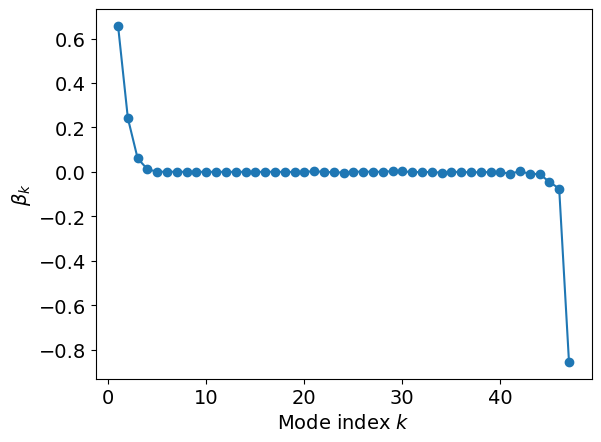

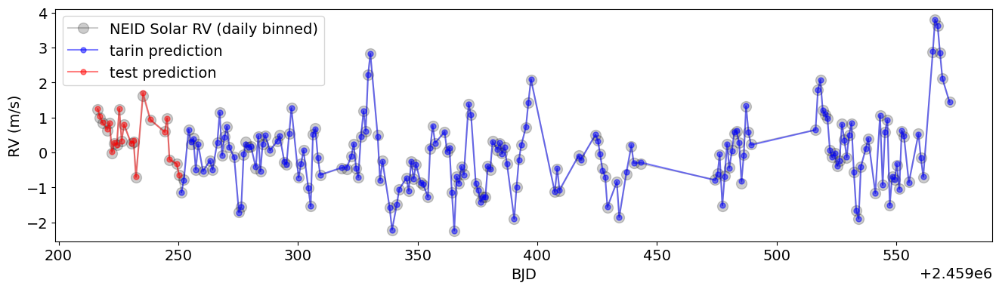

2


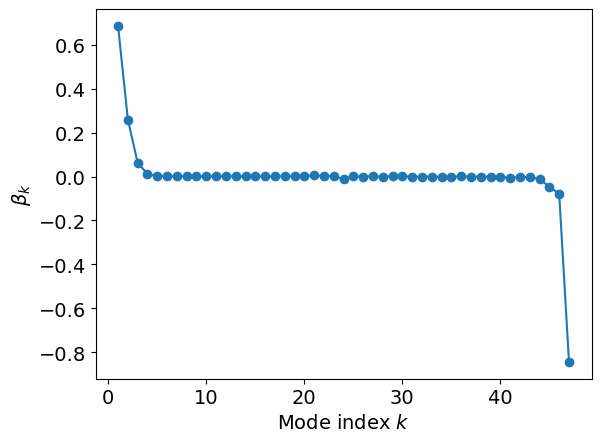

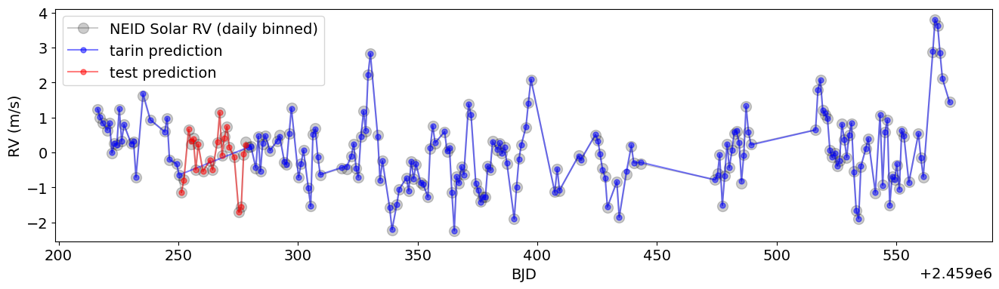

3


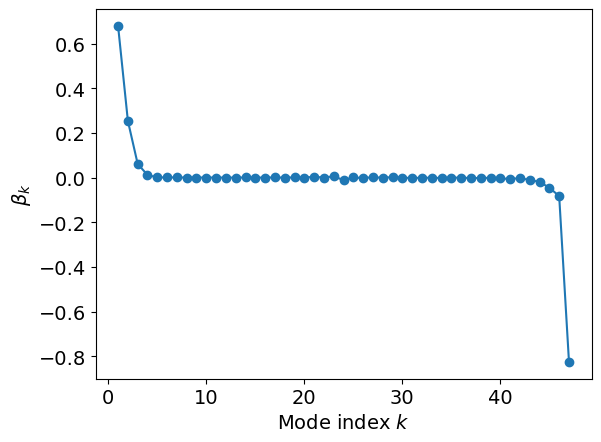

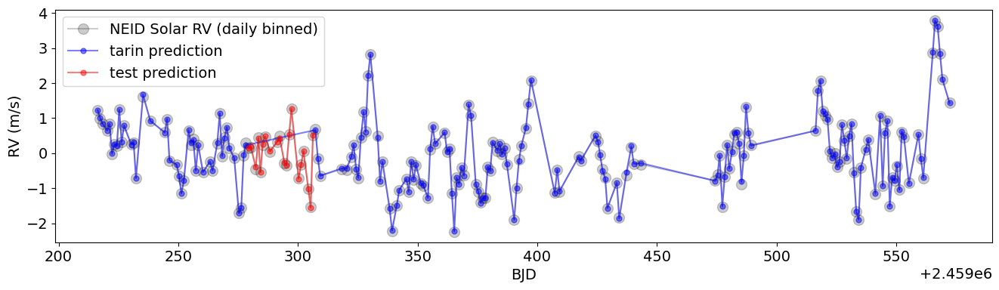

4


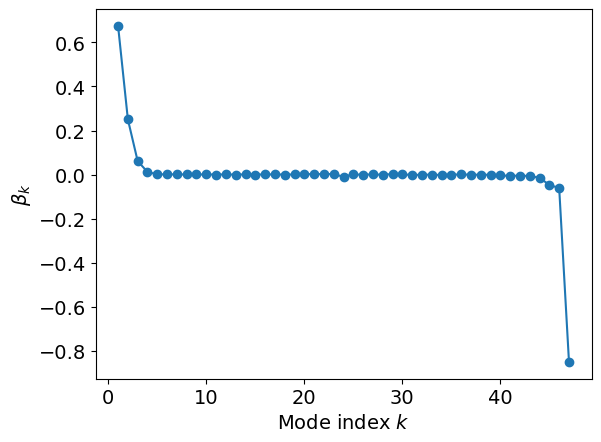

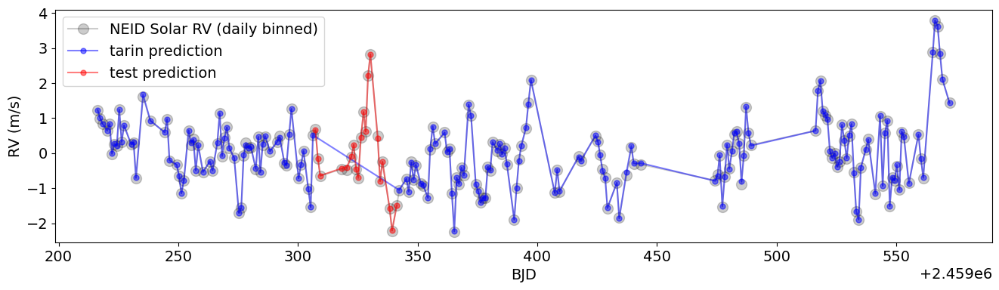

5


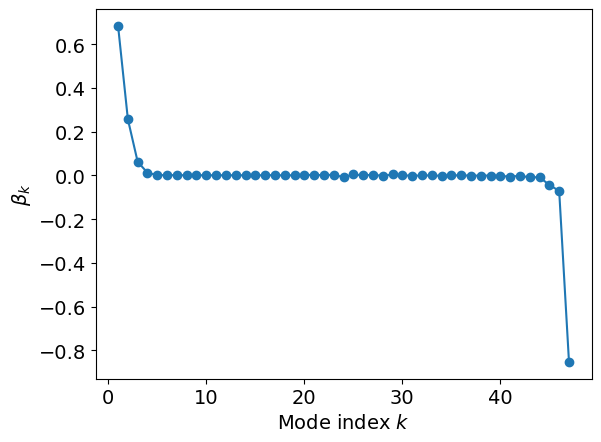

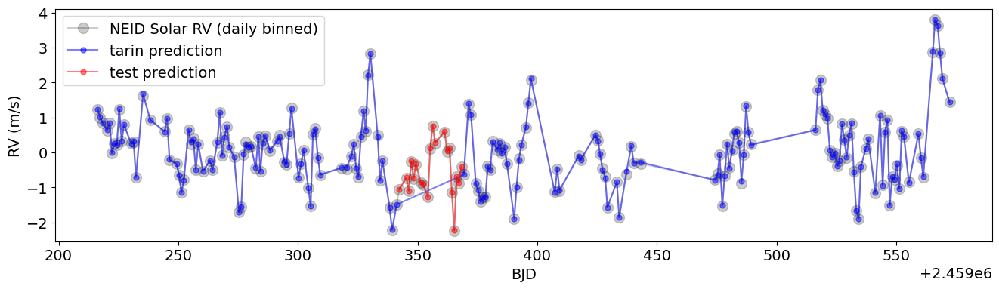

6


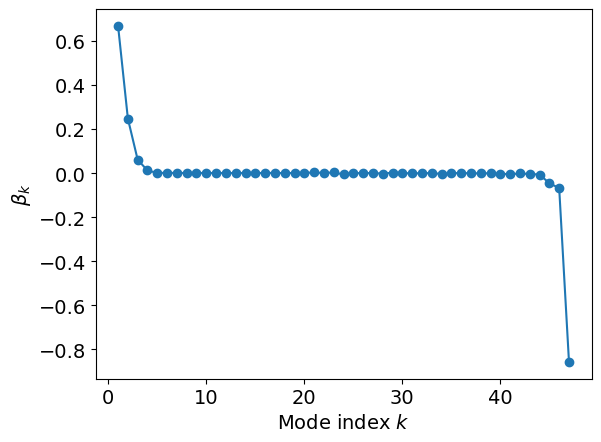

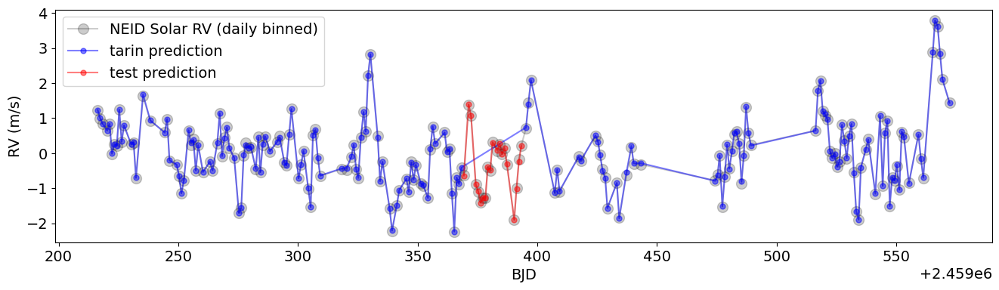

7


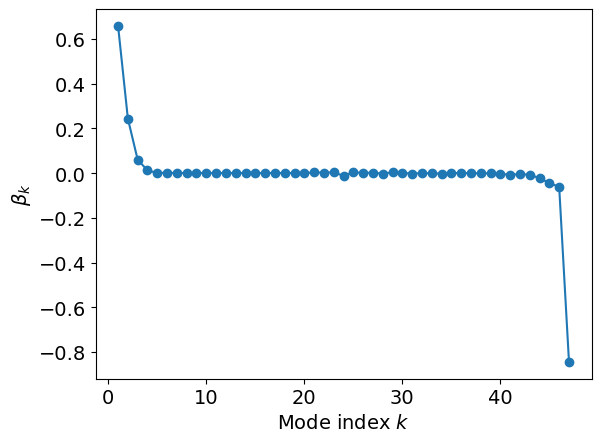

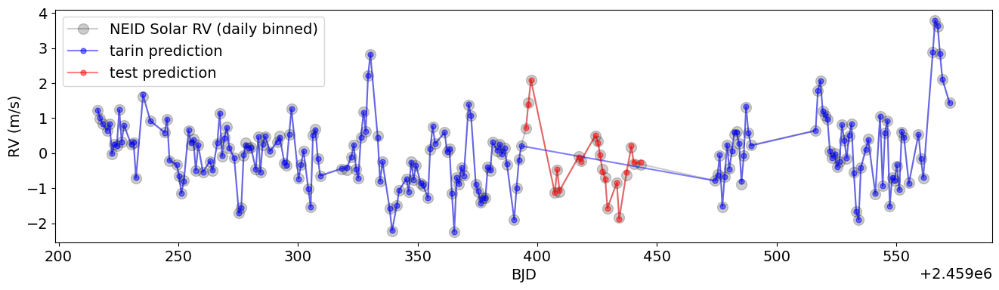

8


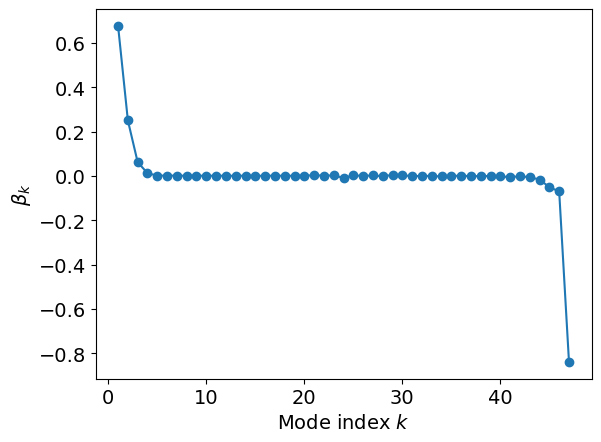

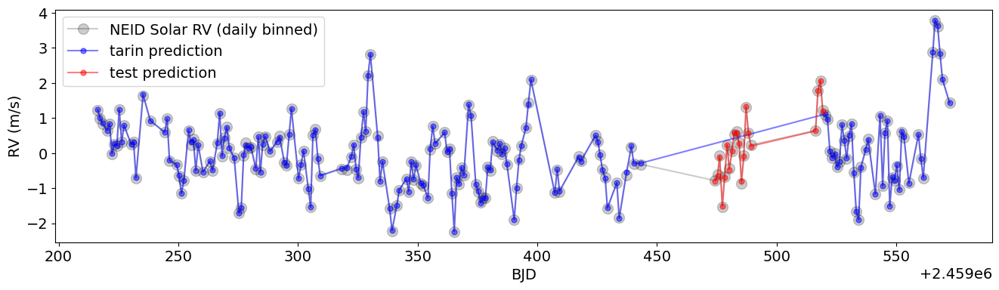

9


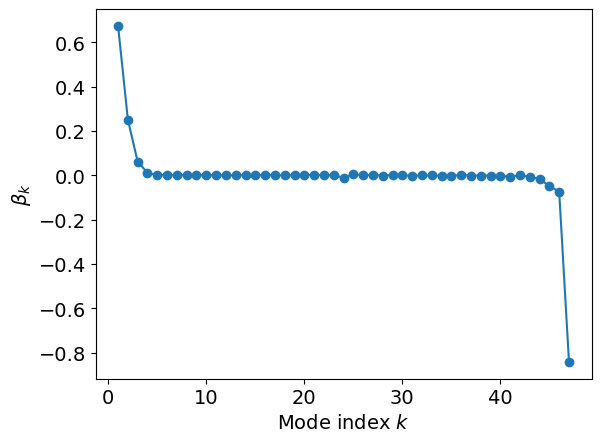

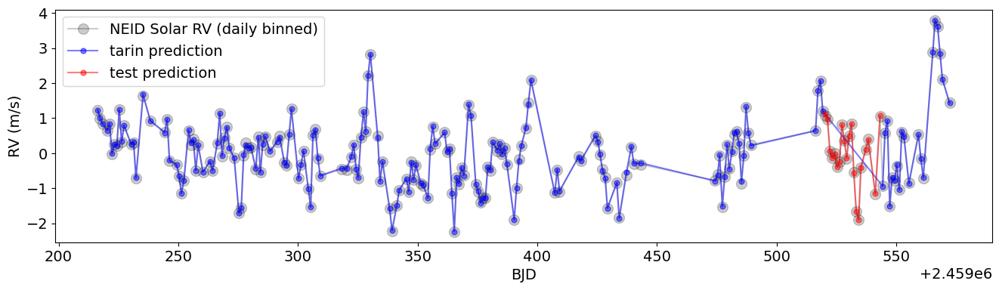

10


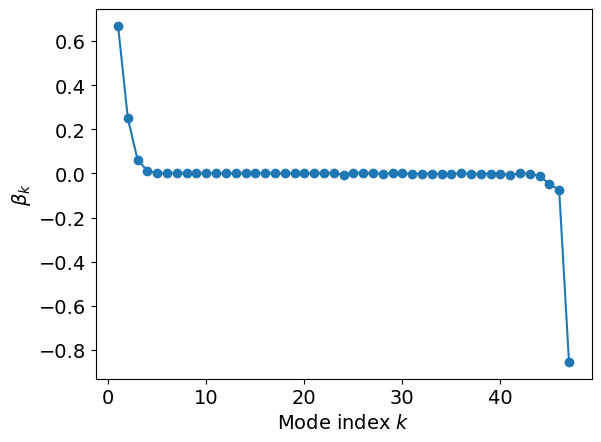

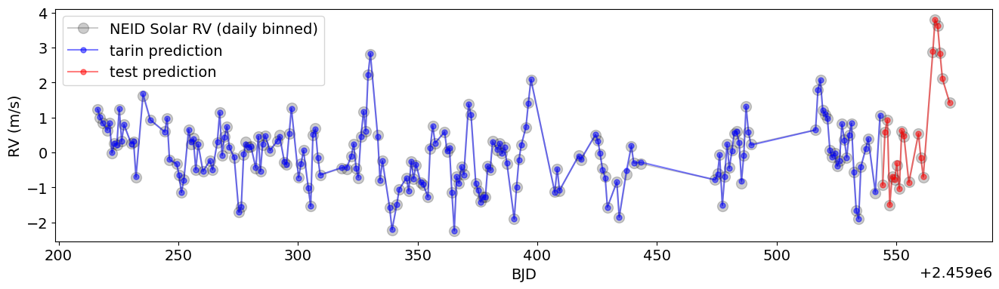

In [258]:
from scipy import optimize

order_max = 47
X = ΔRV_k[:order_max].T
Y = rv_daily - np.mean(rv_daily) 

wrms_train = np.zeros(10)
wrms_test = np.zeros(10)
wrms_all = np.zeros(10)
weights = np.zeros((10, order_max))


for kk in range(11):
    kf = KFold(n_splits=10)
    i = 0
    for train_index, test_index in kf.split(X):
        i+=1
        if i==kk:
            print (i)
            t_train, y_train, σrv_train, x_train = bjd_daily[train_index], Y[train_index], σrv_daily[train_index], X[train_index]
            t_test, y_test, σrv_test, x_test = bjd_daily[test_index], Y[test_index], σrv_daily[test_index], X[test_index]

            def loss(params):
                diff = np.sum(params[:order_max]*x_train, axis=1) + params[order_max] - y_train
                _, wrms = weighted_avg_and_std(diff, 1/σrv_train**2)
                return wrms

            initial_guess = np.zeros(order_max+1)
            result = optimize.minimize(loss, initial_guess)

            fitted_params = result.x
            weights[i-1,:] = fitted_params[:order_max]
            
            plt.plot(np.arange(order_max)+1, fitted_params[:order_max], 'o-')     
            plt.xlabel('Mode index $k$')
            plt.ylabel(r'$\beta_k$')            
            plt.show()
            
            y_pred = np.sum(fitted_params[:order_max]*x_test, axis=1) + fitted_params[order_max]
            y_pred_train = np.sum(fitted_params[:order_max]*x_train, axis=1) + fitted_params[order_max]
            fig = plt.figure(figsize=(16, 4))
            plt.plot(bjd_daily, Y, marker='.', ms=20, color='black', ls='-', alpha=0.2, label='NEID Solar RV (daily binned)')
            plt.plot(t_train, y_pred_train, marker='.', ms=10, color='blue', ls='-', alpha=0.5, label='tarin prediction')
            plt.plot(t_test, y_pred, marker='.', ms=10, color='red', ls='-', alpha=0.5, label='test prediction')
            # plt.ylim([np.median(rv-np.mean(rv_daily))-4, np.median(rv-np.mean(rv_daily))+5])
            # plt.title('Random RV injection')
            plt.xlabel('BJD')
            plt.ylabel('RV (m/s)')
            plt.legend(loc=2)
            # plt.savefig('../Figures/Postdoc application/NEID Solar RV (Year 2021) and FIESTA prediction.png')
            plt.show()        
    
            _, wrms_train[i-1] = weighted_avg_and_std(y_pred_train-y_train, 1/σrv_train**2)
            _, wrms_test[i-1] = weighted_avg_and_std(y_pred-y_test, 1/σrv_test**2)
            # y_pred_all = np.sum(fitted_params[:47]*RV_FT_k.T, axis=1) + fitted_params[47]
            # wrms_all[i-1] = np.std(y_pred_all)
    

In [259]:
weights_mean = np.mean(weights, axis=0)
weights_mean.shape

(47,)

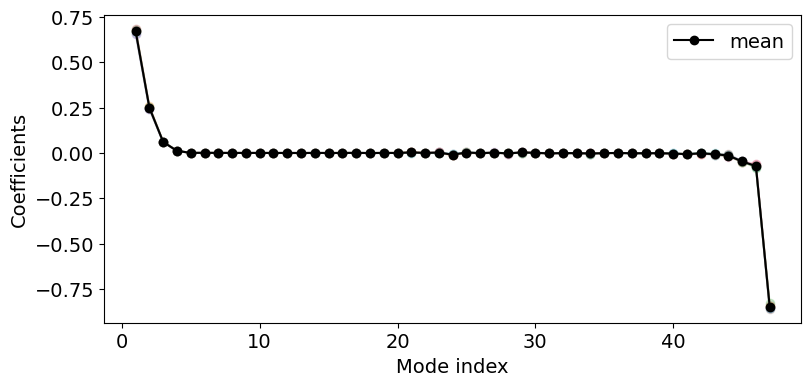

In [260]:
fig = plt.figure(figsize=(9, 4))
plt.plot(np.arange(order_max)+1, weights.T, 'o-', alpha=0.2)
# plt.plot(np.arange(47)+1, np.mean(weights, axis=0), 'ko-', alpha=1, label='mean')
plt.plot(np.arange(order_max)+1, weights_mean, 'ko-', alpha=1, label='mean')
# plt.plot(np.arange(47)+1, np.std(RV_FT_k, axis=1)/sum(np.std(RV_FT_k, axis=1))*np.mean(weights, axis=0), 'ro-', alpha=1, label='percentage')
plt.xlabel('Mode index')
plt.ylabel('Coefficients')
plt.legend()
# plt.savefig('../Figures/Coefficients_Delta_RV_k.png')
plt.show()

In [216]:
X.shape, weights_mean.shape, (X*weights_mean).shape

((202, 20), (20,), (202, 20))

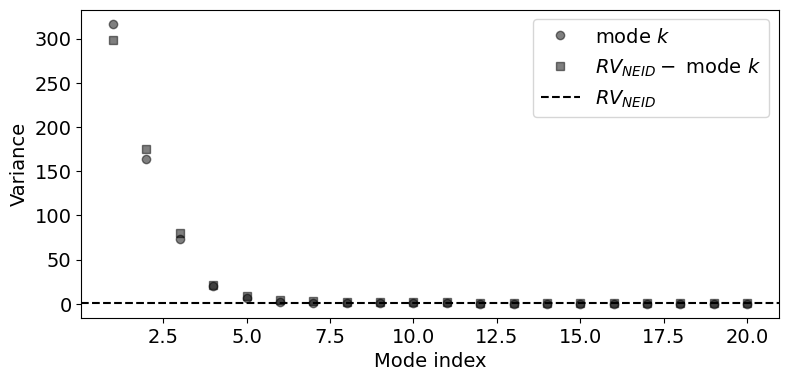

In [217]:
fig = plt.figure(figsize=(9, 4))


# plt.plot(np.arange(47)+1, np.std(X*weights_mean, axis=0)**2, 'o-', alpha=0.5, label='mode $k$')

for i in range(order_max):
    _, wrms = weighted_avg_and_std(X[:,i]*weights_mean[i], 1/σrv_daily**2)
    if i == 0:
        plt.plot(i+1, wrms**2, 'ko', alpha=0.5, label='mode $k$')
    else:
        plt.plot(i+1, wrms**2, 'ko', alpha=0.5)
        
    _, wrms = weighted_avg_and_std(Y-X[:,i]*weights_mean[i], 1/σrv_daily**2)
    if i == 0:
        plt.plot(i+1, wrms**2, 'ks', alpha=0.5, label=r'$RV_{NEID} -$ mode $k$')
    else:
        plt.plot(i+1, wrms**2, 'ks', alpha=0.5)
    if wrms**2 < weighted_avg_and_std(Y, 1/σrv_daily**2)[1]**2*0.9:
        plt.plot(i+1, wrms**2, 'rs')
    
    
_, wrms = weighted_avg_and_std(Y, 1/σrv_daily**2)    
plt.axhline(y = wrms**2, color = 'k', linestyle = '--', label=r'$RV_{NEID}$')
    
plt.xlabel('Mode index')
plt.ylabel('Variance')
plt.legend()
# plt.savefig('../Figures/Coefficients_Delta_RV_k.png')
plt.show()

In [218]:
np.std(Y), np.std(Y-np.sum(X*weights_mean, axis=1))

(0.9915723287820736, 0.5066650079754595)

### use only a few modes 

In [133]:
mode_idx = []

for i in range(47):
    _, wrms = weighted_avg_and_std(Y-X[:,i]*weights_mean[i], 1/σrv_daily**2)
    mode_idx.append(wrms**2 < weighted_avg_and_std(Y, 1/σrv_daily**2)[1]**2*0.9)
    
print(mode_idx)  
print(sum(mode_idx))

[True, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, True, False, True, False, True, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, True, True, True, True]
8


In [134]:
X.shape

(202, 47)

rms = 0.3687269791193374


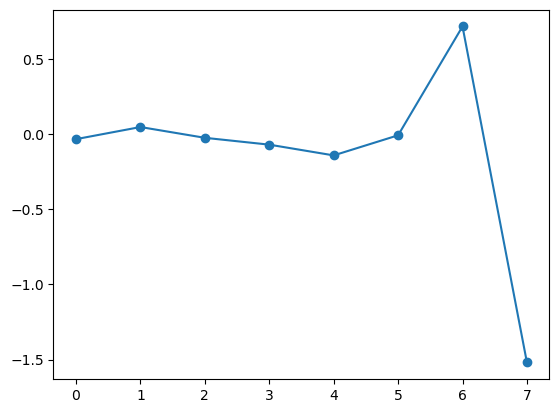

In [135]:
X = ΔRV_k.T
Y = rv_daily - np.mean(rv_daily) 

def loss(params):
    diff = np.sum(params[:8]*X[:,mode_idx], axis=1) + params[8] - Y
    _, wrms = weighted_avg_and_std(diff, 1/σrv_daily**2)
    return wrms

initial_guess = np.zeros(9)
result = optimize.minimize(loss, initial_guess)
if result.success:
    fitted_params = result.x
    print('rms =', loss(fitted_params))
else:
    raise ValueError(result.message)    

plt.plot(fitted_params[:8], 'o-')  
    

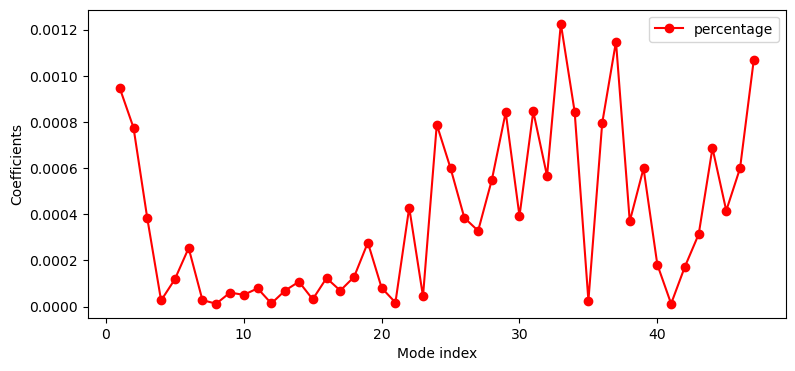

In [84]:
fig = plt.figure(figsize=(9, 4))
# plt.plot(np.arange(47)+1, weights.T, 'o-', alpha=0.2)
# plt.plot(np.arange(47)+1, np.mean(weights, axis=0), 'ko-', alpha=1, label='mean')
# plt.plot(np.arange(47)+1, np.std(RV_FT_k, axis=1)/sum(np.std(RV_FT_k, axis=1))*np.mean(weights, axis=0), 'ro-', alpha=1, label='percentage')
plt.plot(np.arange(47)+1, np.std(X, axis=0)/sum(np.std(X, axis=0))*abs(np.mean(weights, axis=0)), 'ro-', alpha=1, label='percentage')
plt.xlabel('Mode index')
plt.ylabel('Coefficients')
plt.legend()
# plt.savefig('../Figures/Coefficients_Delta_RV_k.png')
plt.show()

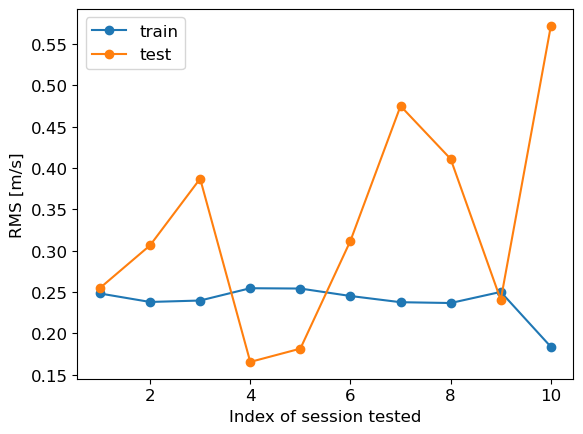

In [114]:
plt.plot(np.arange(10)+1, wrms_train, 'o-', label='train')
plt.plot(np.arange(10)+1, wrms_test, 'o-', label='test')
plt.xlabel('Index of session tested')
plt.ylabel('RMS [m/s]')
plt.legend()
plt.savefig('../Figures/RMS - Index of session tested.png')
plt.show()

1


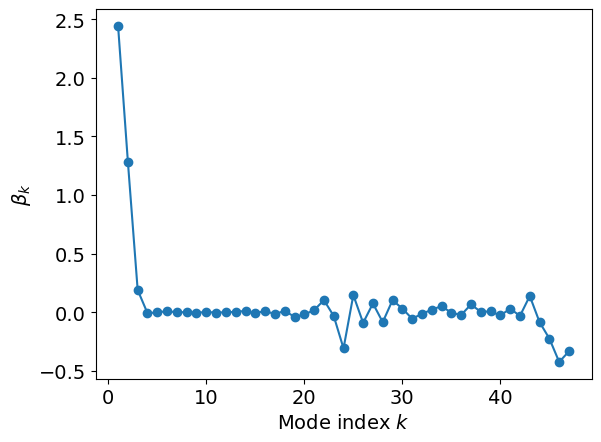

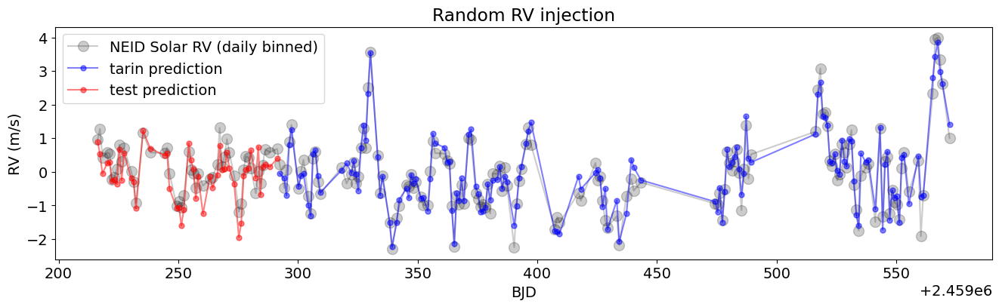

2


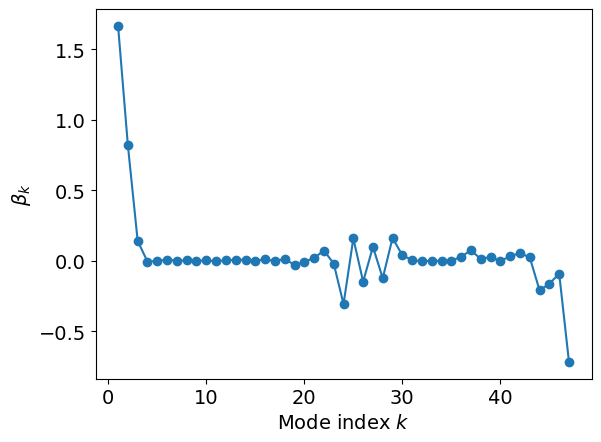

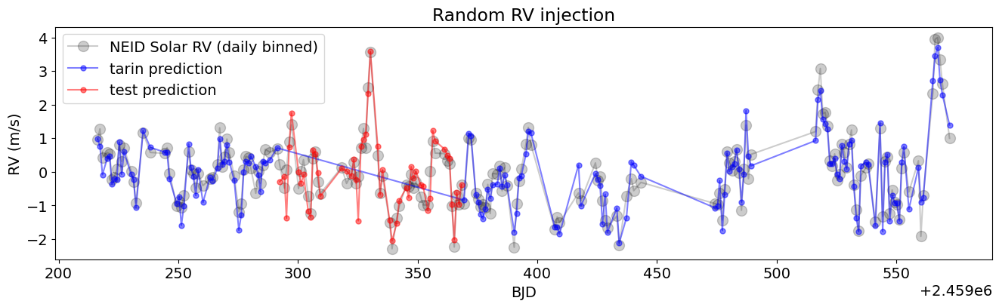

3


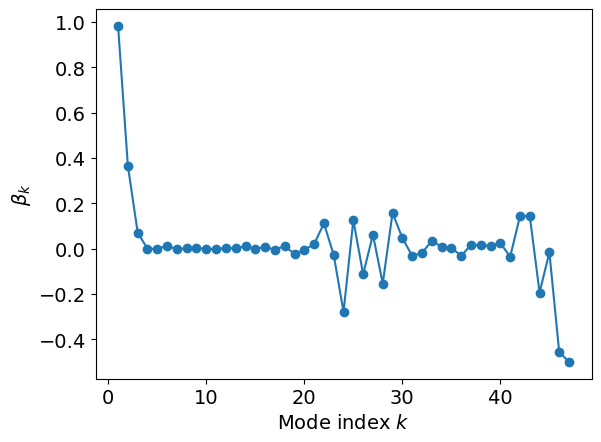

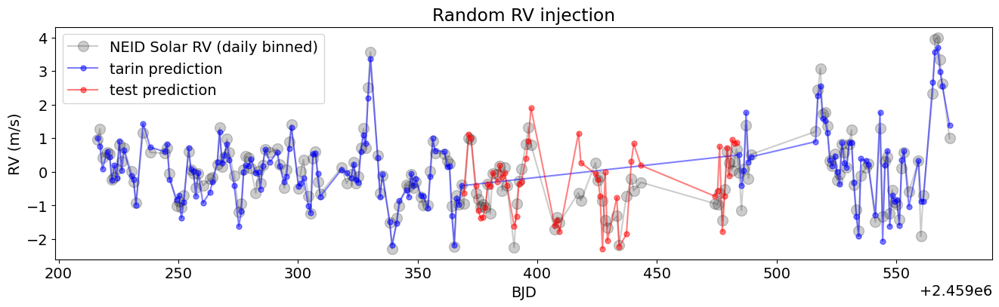

4


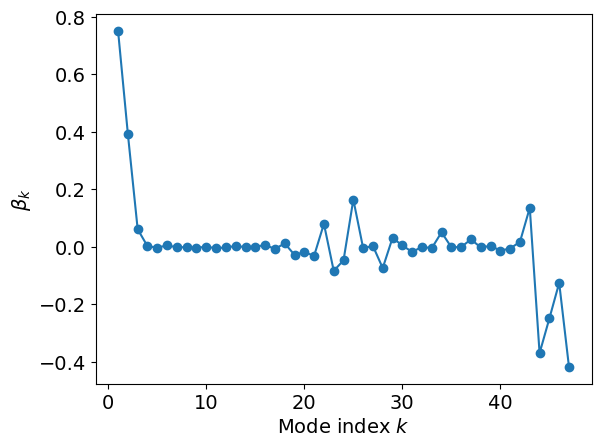

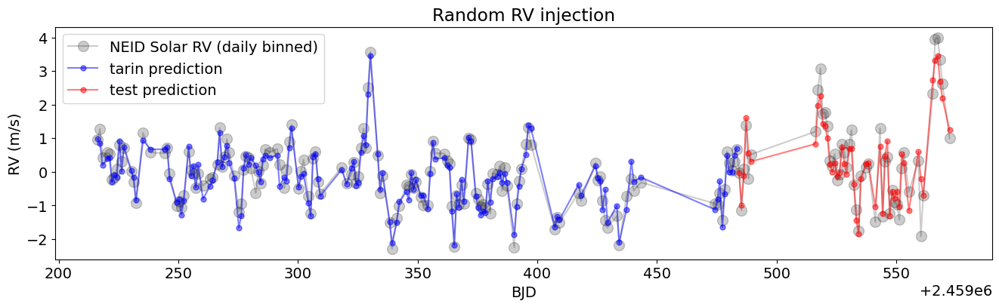

In [149]:
X = ΔRV_k.T
Y = rv_daily - np.mean(rv_daily) 

n_splits = 4
wrms_train = np.zeros(n_splits)
wrms_test = np.zeros(n_splits)
wrms_all = np.zeros(n_splits)

for kk in range(n_splits+1):
    kf = KFold(n_splits=n_splits)
    i = 0
    for train_index, test_index in kf.split(X):
        i+=1
        if i==kk:
            print (i)
            t_train, y_train, σrv_train, x_train = bjd_daily[train_index], Y[train_index], σrv_daily[train_index], X[train_index]
            t_test, y_test, σrv_test, x_test = bjd_daily[test_index], Y[test_index], σrv_daily[test_index], X[test_index]

            def loss(params):
                diff = np.sum(params[:47]*x_train, axis=1) + params[47] - y_train
                _, wrms = weighted_avg_and_std(diff, 1/σrv_train**2)
                return wrms

            initial_guess = np.zeros(48)
            result = optimize.minimize(loss, initial_guess)

            fitted_params = result.x
            
            plt.plot(np.arange(47)+1, fitted_params[:47], 'o-')     
            plt.xlabel('Mode index $k$')
            plt.ylabel(r'$\beta_k$')            
            plt.show()
            
            y_pred = np.sum(fitted_params[:47]*x_test, axis=1) + fitted_params[47]
            y_pred_train = np.sum(fitted_params[:47]*x_train, axis=1) + fitted_params[47]
            fig = plt.figure(figsize=(16, 4))
            plt.plot(bjd_daily, Y, marker='.', ms=20, color='black', ls='-', alpha=0.2, label='NEID Solar RV (daily binned)')
            plt.plot(t_train, y_pred_train, marker='.', ms=10, color='blue', ls='-', alpha=0.5, label='tarin prediction')
            plt.plot(t_test, y_pred, marker='.', ms=10, color='red', ls='-', alpha=0.5, label='test prediction')
            # plt.ylim([np.median(rv-np.mean(rv_daily))-4, np.median(rv-np.mean(rv_daily))+5])
            plt.title('Random RV injection')
            plt.xlabel('BJD')
            plt.ylabel('RV (m/s)')
            plt.legend(loc=2)
            # plt.savefig('../Figures/Postdoc application/NEID Solar RV (Year 2021) and FIESTA prediction.png')
            plt.show()        
    
            _, wrms_train[i-1] = weighted_avg_and_std(y_pred_train-y_train, 1/σrv_train**2)
            _, wrms_test[i-1] = weighted_avg_and_std(y_pred-y_test, 1/σrv_test**2)
            # y_pred_all = np.sum(fitted_params[:47]*RV_FT_k.T, axis=1) + fitted_params[47]
            # wrms_all[i-1] = np.std(y_pred_all)

            

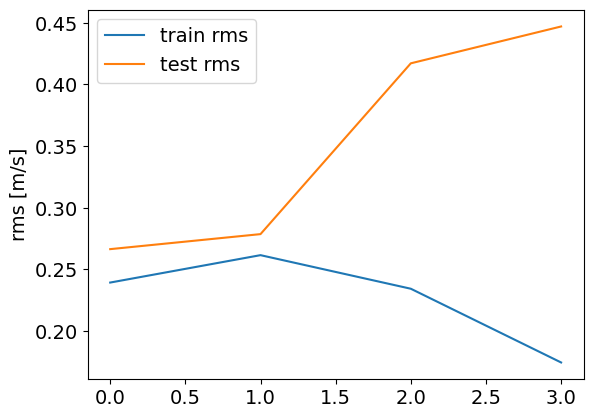

In [151]:
plt.plot(wrms_train, label='train rms')
plt.plot(wrms_test, label='test rms')
plt.ylabel('rms [m/s]')
plt.legend()
plt.show()

In [ ]:
from sklearn.linear_model import LinearRegression
import cv2

img_array = []
rms = np.zeros(47)

for i in range(47):
    n_feature = i+1
    X_feature = RV_FT_k[:n_feature]
    X = (X_feature+random_rv_shift).T
    Y = random_rv_shift

    # X = RV_FT_k.T
    # Y = np.zeros(len(rv_daily))

    reg = LinearRegression().fit(X, Y, sample_weight=1/σrv_daily**2)
    # print(reg.score(X, Y), 
    #       reg.coef_, 
    #       reg.intercept_)
    
    fig = plt.figure()
    plt.plot(reg.coef_, 'ko-')
    plt.xlabel('Frequency mode')
    plt.ylabel('Mode amplitude')
    plt.xlim([-1, 48])
    plt.ylim([-0.65,1.05])
    
    filename = '../Figures/Mode amplitude/' + str(n_feature) + '.png'
    plt.savefig(filename)
    plt.close()
    
    img = cv2.imread(filename)
    height, width, layers = img.shape
    size = (width, height)
    img_array.append(img)

    y_pred = reg.predict(X_feature.T)
    rms[i]=np.std(y_pred)
    
out = cv2.VideoWriter('../Videos/Mode amplitude.mp4', cv2.VideoWriter_fourcc(*'DIVX'), 10, size) 
for i in range(len(img_array)):
	out.write(img_array[i])
out.release()

In [ ]:
plt.plot(np.arange(47)+1, rms)
plt.xlabel('frequency modes used')
plt.ylabel('rms')

In [ ]:
from sklearn.linear_model import LinearRegression
import cv2

img_array = []
rms = np.zeros(47)

for i in range(47):
    n_feature = i+1

    X = ΔRV_k[:n_feature].T
    Y = rv_daily - np.mean(rv_daily)

    reg = LinearRegression().fit(X, Y, sample_weight=1/σrv_daily**2)
    # print(reg.score(X, Y), 
    #       reg.coef_, 
    #       reg.intercept_)
    
    fig = plt.figure()
    plt.plot(reg.coef_, 'ko-')
    plt.xlabel('Frequency mode')
    plt.ylabel('Mode amplitude')
    # plt.xlim([-1, 48])
    # plt.ylim([-0.65,1.05])
    
    filename = '../Figures/Mode amplitude 2/' + str(n_feature) + '.png'
    plt.savefig(filename)
    plt.close()
    
    img = cv2.imread(filename)
    height, width, layers = img.shape
    size = (width, height)
    img_array.append(img)

    y_pred = reg.predict(X)
    rms[i]=np.std(y_pred-Y)
    
out = cv2.VideoWriter('../Videos/Mode amplitude 2.mp4', cv2.VideoWriter_fourcc(*'DIVX'), 10, size) 
for i in range(len(img_array)):
	out.write(img_array[i])
out.release()

In [ ]:
plt.plot(np.arange(47)+1, rms)
plt.xlabel('frequency modes used')
plt.ylabel('rms')

In [ ]:
# np.sqrt(lr_model_history.history['loss'])[-5:], lr_model_history.history['val_loss'][-5:]

In [ ]:
# np.random.rand(3,2)+ np.array([1,2])*10, (RV_FT_k+random_rv_shift).shape


In [ ]:
for i in range(run):
    plt.plot(abs(np.median(weights,axis=0).T), 'ko-', alpha=1)
    plt.plot(abs(weights.T), 'o-', alpha=0.1)
    plt.xlabel('mode')
    plt.ylabel('weights')
    plt.yscale('log')
    # plt.legend()
plt.show()    

In [ ]:

plt.plot(bjd_daily, weighted_avg_2D(X, weights=lr_model.get_weights()[0].flatten()), 'r.', label='weighted average')
plt.plot(bjd_daily, Y, 'b.', label='injected RV')
# plt.xlim([min(bjd_daily), max(bjd_daily) ])
# plt.legend()
plt.show()

### use ΔRV_k as input features

In [ ]:
# X = ΔRV_k.T[:,0:10]
X = ΔRV_k.T
Y = rv_daily - np.mean(rv_daily) #+ 0.1*np.sin((bjd_daily-min(bjd_daily))*10)
print(X.shape, Y.shape)
###################
# build the model #
###################
input_dim = X.shape[1]
lr_model = Sequential()
# lr_model.add(Dense(32, activation=tf.nn.relu, kernel_initializer='uniform', 
#                 input_dim = input_dim)) 
# lr_model.add(Dense(16, kernel_initializer='uniform', activation=tf.nn.relu))
# lr_model.add(Dense(16, activation=tf.keras.activations.linear, kernel_initializer='uniform', 
#                 input_dim = input_dim)) # add bias term!
# lr_model.add(Dense(20, kernel_initializer='uniform', activation=tf.nn.relu))
# lr_model.add(Dense(20, kernel_initializer='uniform', activation=tf.nn.relu))
# lr_model.add(Dense(20, kernel_initializer='uniform', activation=tf.nn.tanh))
lr_model.add(Dense(1, activation=tf.keras.activations.linear, kernel_initializer='uniform', 
                input_dim = input_dim))

# lr_model.add(Dense(1, kernel_initializer='uniform', activation=tf.keras.activations.linear))

lr_model_history, y_test, y_pred, σrv_test, bjd_test, std = model_MLP(X, Y, bjd_daily, σrv_daily, lr_model, epochs=1500, learning_rate=1e-3)



# Simultaneously fit planetary and stellar RV

In [209]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import make_regression
from sklearn.preprocessing import MinMaxScaler
from tensorflow import keras
from tensorflow.keras import backend as K
import tensorflow as tf
from sklearn.model_selection import train_test_split
np.random.seed(0)
tf.keras.backend.set_floatx('float32')


### optimisation 

In [261]:
def loss(params):
    diff = np.sum(params[:order_max]*X, axis=1) + params[order_max] - Y
    _, wrms = weighted_avg_and_std(diff, 1/σrv_daily**2)
    return wrms
    
initial_guess = np.zeros(order_max+1)
result = optimize.minimize(loss, initial_guess)
if result.success:
    fitted_params = result.x
    print('rms =', loss(fitted_params))
else:
    raise ValueError(result.message)    

plt.plot(np.arange(order_max)+1, fitted_params[:order_max], 'o-')     
plt.xlabel('Mode index $k$')
plt.ylabel(r'$\beta_k$')

ValueError: Desired error not necessarily achieved due to precision loss.

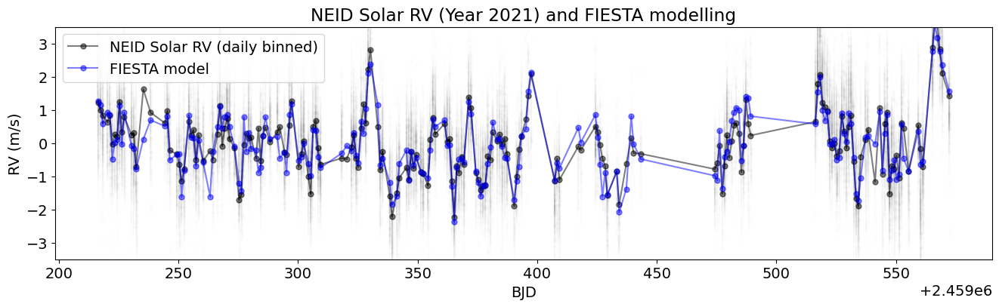

In [257]:
y_pred = np.sum(fitted_params[:order_max]*X, axis=1) + fitted_params[order_max]

plt.rcParams['font.size'] = '14'
fig = plt.figure(figsize=(16, 4))

plt.errorbar(bjd, rv-np.median(rv), σrv, marker='.', ms=5, color='black', ls='none', alpha=0.005)
plt.plot(bjd_daily, rv_daily-np.mean(rv_daily), marker='.', ms=10, color='black', ls='-', alpha=0.5, label='NEID Solar RV (daily binned)')
plt.plot(bjd_daily, y_pred, marker='.', ms=10, color='blue', ls='-', alpha=0.5, label='FIESTA model')
# plt.ylim([np.median(rv-np.mean(rv_daily))-4, np.median(rv-np.mean(rv_daily))+5])
plt.ylim([-3.5,3.5])
plt.title('NEID Solar RV (Year 2021) and FIESTA modelling')
plt.xlabel('BJD')
plt.ylabel('RV (m/s)')
plt.legend(loc=2)
# plt.savefig('../Figures/Postdoc application/NEID Solar RV (Year 2021) and FIESTA prediction.png')
plt.show()

### include an injected planet 

In [164]:
N =1 
amp = np.logspace(-0, 2, N)
t = bjd_daily - min(bjd_daily)
# N = 100
# amp = np.logspace(-2, 2, N)
amp_pred = np.zeros(N)
w_array = np.zeros((N, 47))
rms_array = np.zeros(N)
phase_array = np.zeros(N)
t_array = np.zeros(N)
initial_guess = np.zeros(51)


if 0:
    def loss(params):    
        diff = np.sum(params[:47]*X, axis=1) + params[47] + params[48] * np.sin(t+params[49]) - y
        _, wrms = weighted_avg_and_std(diff, 1/σrv_daily**2)
        return wrms

def loss(params):    
    diff = np.sum(params[:47]*X, axis=1) + params[47] + params[48] * np.sin(params[50]*t+params[49]) - y
    _, wrms = weighted_avg_and_std(diff, 1/σrv_daily**2)
    return wrms

for i in range(N):
    y = Y + amp[i] * np.sin(0.5*t+1)

    result = optimize.minimize(loss, initial_guess)
    fitted_params = result.x
    # print(fitted_params)
    # print('rms =', loss(fitted_params))
    w_array[i] = fitted_params[:47]
    amp_pred[i] = fitted_params[48]
    phase_array[i] = fitted_params[49]
    t_array[i] = fitted_params[50]
    rms_array[i] = loss(fitted_params)
    
print(amp)

[1.]


In [165]:
rms_array, phase_array, t_array, amp_pred 

(array([0.65683073]), array([0.]), array([0.]))

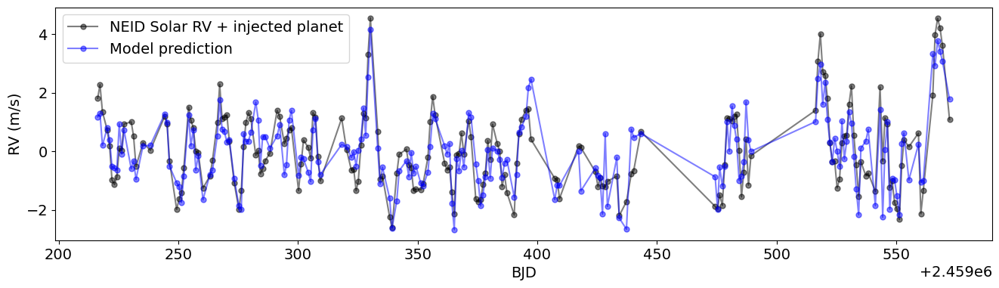

In [169]:
y_pred = np.sum(fitted_params[:47]*X, axis=1) + fitted_params[47] + fitted_params[48] * np.sin(fitted_params[50]*t+fitted_params[49])

plt.rcParams['font.size'] = '14'
fig = plt.figure(figsize=(16, 4))

plt.plot(bjd_daily, y, marker='.', ms=10, color='black', ls='-', alpha=0.5, label='NEID Solar RV + injected planet')
plt.plot(bjd_daily, y_pred, marker='.', ms=10, color='blue', ls='-', alpha=0.5, label='Model prediction')
# plt.ylim([np.median(rv-np.mean(rv_daily))-4, np.median(rv-np.mean(rv_daily))+5])
# plt.title('Planet injection')
plt.xlabel('BJD')
plt.ylabel('RV (m/s)')
plt.legend(loc=2)
plt.savefig('../Figures/NEID Solar RV (Year 2021) and FIESTA prediction - all.png')
plt.show()

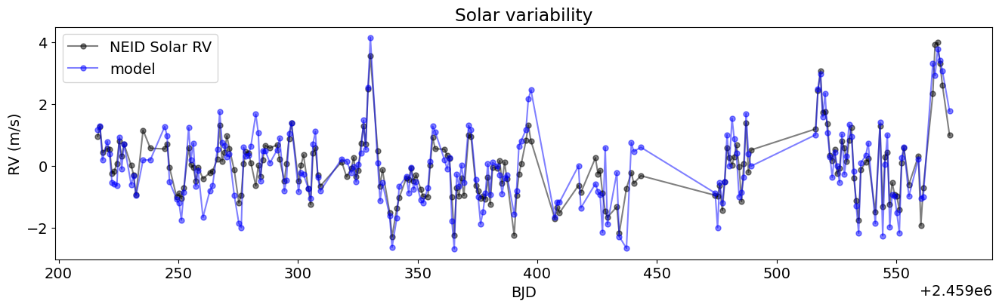

In [167]:
y_sun = np.sum(fitted_params[:47]*X, axis=1) + fitted_params[47]

plt.rcParams['font.size'] = '14'
fig = plt.figure(figsize=(16, 4))

plt.plot(bjd_daily, Y, marker='.', ms=10, color='black', ls='-', alpha=0.5, label='NEID Solar RV')
plt.plot(bjd_daily, y_sun, marker='.', ms=10, color='blue', ls='-', alpha=0.5, label='model')
# plt.ylim([np.median(rv-np.mean(rv_daily))-4, np.median(rv-np.mean(rv_daily))+5])
plt.title('Solar variability')
plt.xlabel('BJD')
plt.ylabel('RV (m/s)')
plt.legend(loc=2)
plt.savefig('../Figures/NEID Solar RV (Year 2021) and FIESTA prediction - solar.png')
plt.show()

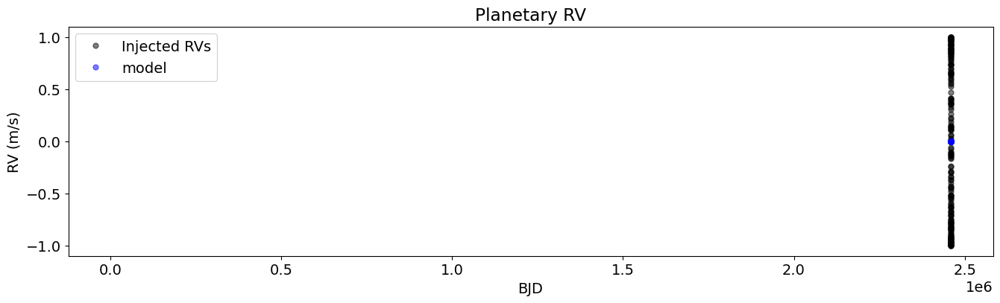

In [168]:
y_planet = fitted_params[48] * np.sin(t+fitted_params[49])
x_plot = np.linspace(min(t), max(t), 1000)

plt.rcParams['font.size'] = '14'
fig = plt.figure(figsize=(16, 4))

plt.plot(bjd_daily, amp[i] * np.sin(t+1), marker='.', ms=10, color='black', ls='', alpha=0.5, label='Injected RVs')
plt.plot(bjd_daily, y_planet, marker='.', ms=10, color='blue', ls='', alpha=0.5, label='model')
plt.plot(x_plot, fitted_params[48] * np.sin(x_plot+fitted_params[49]), '-', alpha =0.2, lw=3)
# plt.ylim([np.median(rv-np.mean(rv_daily))-4, np.median(rv-np.mean(rv_daily))+5])
plt.title('Planetary RV')
plt.xlabel('BJD')
plt.ylabel('RV (m/s)')
plt.legend(loc=2)
plt.savefig('../Figures/NEID Solar RV (Year 2021) and FIESTA prediction - planet.png')
plt.show()

Text(0, 0.5, '$\\beta_k$')

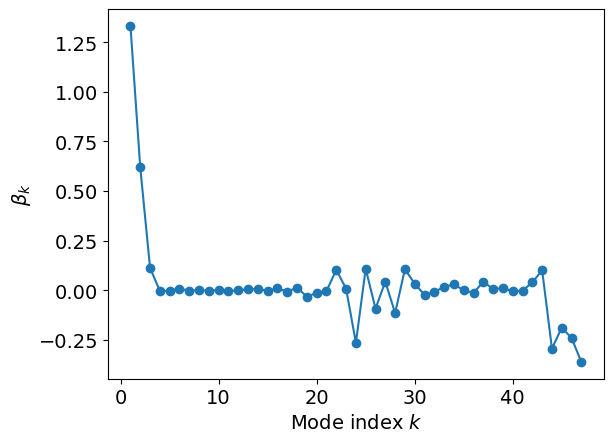

In [160]:
plt.plot(np.arange(47)+1, fitted_params[:47], 'o-')     
plt.xlabel('Mode index $k$')
plt.ylabel(r'$\beta_k$')

In [450]:

N = 100
amp = np.logspace(-2, 1, N)
amp_pred = np.zeros(N)
w_array = np.zeros((N, 47))
rms_array = np.zeros(N)
phase_array = np.zeros(N)
initial_guess = np.zeros(50)


def loss(params):    
    diff = np.sum(params[:47]*X, axis=1) + params[47] + params[48] * np.sin(t+params[49]) - y
    _, wrms = weighted_avg_and_std(diff, 1/σrv_daily**2)
    return wrms

for i in range(N):
    y = Y + amp[i] * np.sin(t+1)

    result = optimize.minimize(loss, initial_guess)
    fitted_params = result.x
    # print(fitted_params)
    # print('rms =', loss(fitted_params))
    w_array[i] = fitted_params[:47]
    amp_pred[i] = fitted_params[48]
    phase_array[i] = fitted_params[49]
    rms_array[i] = loss(fitted_params)
    
# plt.plot(fitted_params[:47], 'o-')    

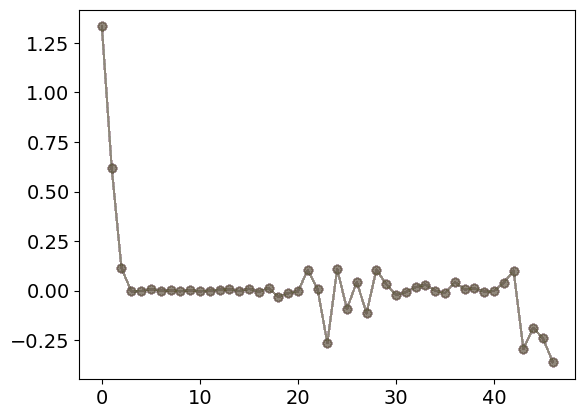

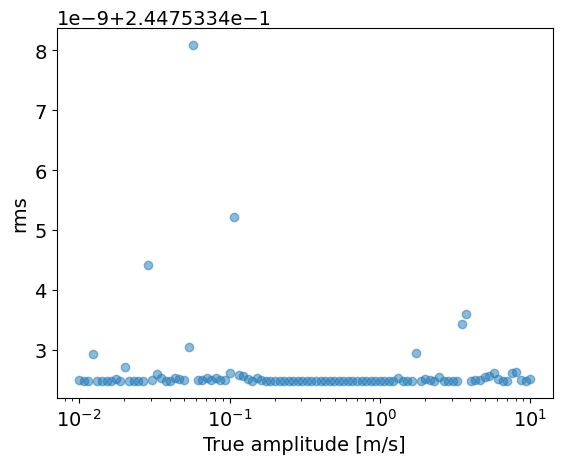

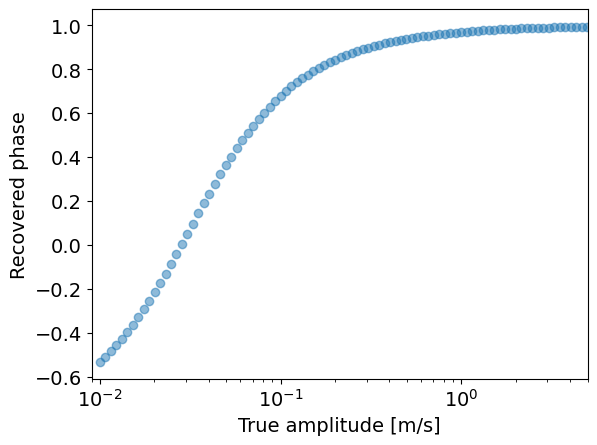

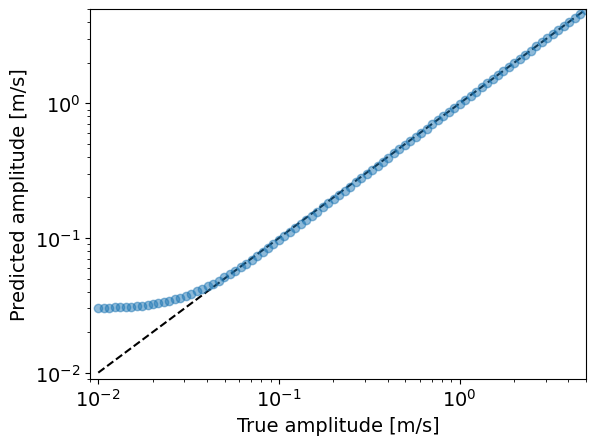

In [451]:
plt.plot(w_array.T, 'o-', alpha=0.01)    
plt.show()

plt.plot(amp, rms_array, 'o', alpha=0.5)
plt.xlabel('True amplitude [m/s]')
plt.ylabel('rms')
plt.xscale('log')
plt.show()

plt.plot(amp, phase_array, 'o', alpha=0.5)
plt.xscale('log')
plt.xlim([0.009, 5])
plt.xlabel('True amplitude [m/s]')
plt.ylabel('Recovered phase')
plt.show()


plt.plot(amp, amp, 'k--')
plt.plot(amp, amp_pred, 'o', alpha=0.5)
plt.xlabel('True amplitude [m/s]')
plt.ylabel('Predicted amplitude [m/s]')
plt.xlim([0.009, 5])
plt.ylim([0.009, 5])
plt.xscale('log')
plt.yscale('log')

### Train-test-split

In [454]:
X.shape, t.shape, Y.shape

((202, 47), (202,), (202,))

rms = 0.14232870245992185


Text(0, 0.5, '$\\beta_k$')

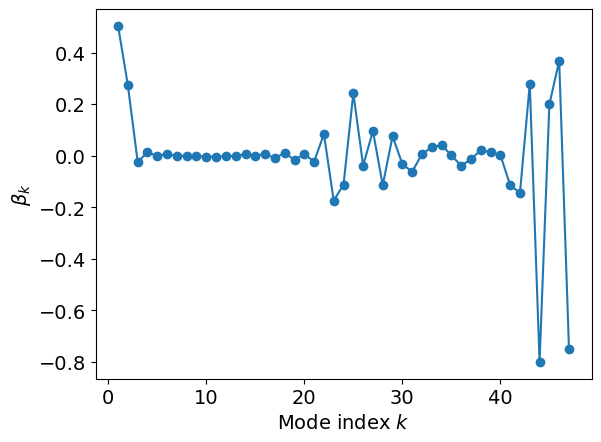

In [478]:
Y = rv_daily-np.mean(rv_daily)

X_train = X[:101]
Y_train = Y[:101]
t_train = t[:101]

def loss(params):
    diff = np.sum(params[:47]*X_train, axis=1) + params[47] - Y_train
    _, wrms = weighted_avg_and_std(diff, 1/σrv_daily[:101]**2)
    return wrms
    
initial_guess = np.zeros(48)
result = optimize.minimize(loss, initial_guess)
if result.success:
    fitted_params = result.x
    print('rms =', loss(fitted_params))
else:
    raise ValueError(result.message)    

plt.plot(np.arange(47)+1, fitted_params[:47], 'o-')     
plt.xlabel('Mode index $k$')
plt.ylabel(r'$\beta_k$')

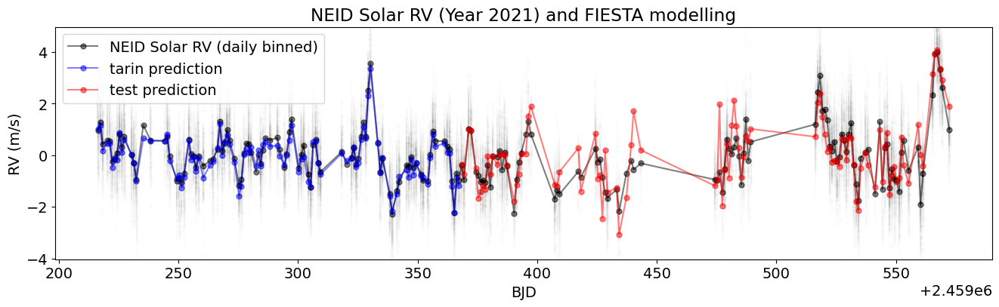

In [479]:
y_pred = np.sum(fitted_params[:47]*X[101:], axis=1) + fitted_params[47]
y_pred_train = np.sum(fitted_params[:47]*X[:101], axis=1) + fitted_params[47]

plt.rcParams['font.size'] = '14'
fig = plt.figure(figsize=(16, 4))

plt.errorbar(bjd, rv-np.mean(rv_daily), σrv, marker='.', ms=5, color='black', ls='none', alpha=0.005)
plt.plot(bjd_daily, Y, marker='.', ms=10, color='black', ls='-', alpha=0.5, label='NEID Solar RV (daily binned)')
plt.plot(bjd_daily[:101], y_pred_train, marker='.', ms=10, color='blue', ls='-', alpha=0.5, label='tarin prediction')
plt.plot(bjd_daily[101:], y_pred, marker='.', ms=10, color='red', ls='-', alpha=0.5, label='test prediction')
plt.ylim([np.median(rv-np.mean(rv_daily))-4, np.median(rv-np.mean(rv_daily))+5])
plt.title('NEID Solar RV (Year 2021) and FIESTA modelling')
plt.xlabel('BJD')
plt.ylabel('RV (m/s)')
plt.legend(loc=2)
# plt.savefig('../Figures/Postdoc application/NEID Solar RV (Year 2021) and FIESTA prediction.png')
plt.show()

rms = 0.23806258280094572


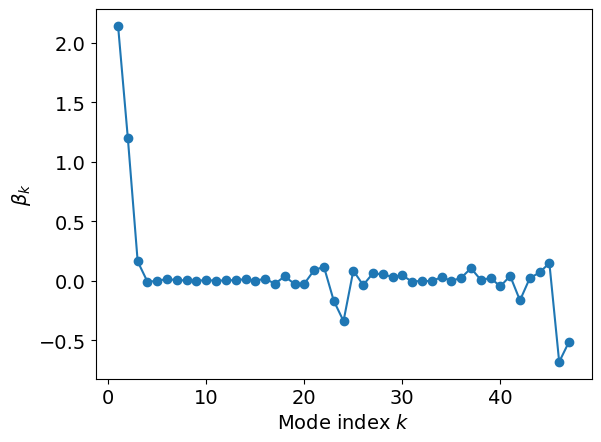

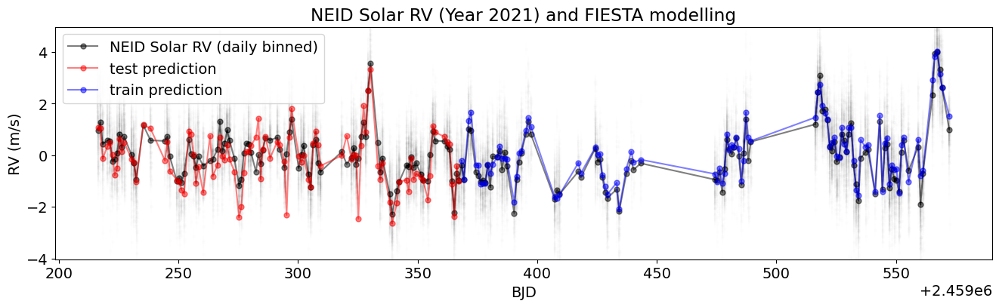

In [470]:
Y = rv_daily-np.mean(rv_daily)

X_train = X[101:]
Y_train = Y[101:]
t_train = t[101:]

def loss(params):
    diff = np.sum(params[:47]*X_train, axis=1) + params[47] - Y_train
    _, wrms = weighted_avg_and_std(diff, 1/σrv_daily[:101]**2)
    return wrms
    
initial_guess = np.zeros(48)
result = optimize.minimize(loss, initial_guess)
if result.success:
    fitted_params = result.x
    print('rms =', loss(fitted_params))
else:
    raise ValueError(result.message)    

plt.plot(np.arange(47)+1, fitted_params[:47], 'o-')     
plt.xlabel('Mode index $k$')
plt.ylabel(r'$\beta_k$')


y_pred = np.sum(fitted_params[:47]*X[:101], axis=1) + fitted_params[47]
y_pred_train = np.sum(fitted_params[:47]*X[101:], axis=1) + fitted_params[47]

plt.rcParams['font.size'] = '14'
fig = plt.figure(figsize=(16, 4))

plt.errorbar(bjd, rv-np.mean(rv_daily), σrv, marker='.', ms=5, color='black', ls='none', alpha=0.005)
plt.plot(bjd_daily, Y, marker='.', ms=10, color='black', ls='-', alpha=0.5, label='NEID Solar RV (daily binned)')
plt.plot(bjd_daily[:101], y_pred, marker='.', ms=10, color='red', ls='-', alpha=0.5, label='test prediction')
plt.plot(bjd_daily[101:], y_pred_train, marker='.', ms=10, color='blue', ls='-', alpha=0.5, label='train prediction')
plt.ylim([np.median(rv-np.mean(rv_daily))-4, np.median(rv-np.mean(rv_daily))+5])
plt.title('NEID Solar RV (Year 2021) and FIESTA modelling')
plt.xlabel('BJD')
plt.ylabel('RV (m/s)')
plt.legend(loc=2)
# plt.savefig('../Figures/Postdoc application/NEID Solar RV (Year 2021) and FIESTA prediction.png')
plt.show()

In [475]:

N = 100
amp = np.logspace(-2, 1, N)
amp_pred = np.zeros(N)
# w_array = np.zeros((N, 47))
rms_array = np.zeros(N)
phase_array = np.zeros(N)
initial_guess = np.zeros(2)


def loss(params):    
    diff = y_pred+ params[0] * np.sin(t[:101]+params[1]) - y
    _, wrms = weighted_avg_and_std(diff, 1/σrv_daily[:101]**2)
    return wrms

for i in range(N):
    y = Y[:101] + amp[i] * np.sin(t[:101]+1)

    result = optimize.minimize(loss, initial_guess)
    fitted_params = result.x
    # print(fitted_params)
    # print('rms =', loss(fitted_params))
    # w_array[i] = fitted_params[:47]
    amp_pred[i] = fitted_params[0]
    phase_array[i] = fitted_params[1]
    rms_array[i] = loss(fitted_params)
    
# plt.plot(fitted_params[:47], 'o-')    

In [480]:

N = 100
amp = np.logspace(-2, 1, N)
amp_pred = np.zeros(N)
# w_array = np.zeros((N, 47))
rms_array = np.zeros(N)
phase_array = np.zeros(N)
initial_guess = np.zeros(2)


def loss(params):    
    diff = y_pred+ params[0] * np.sin(t[101:]+params[1]) - y
    _, wrms = weighted_avg_and_std(diff, 1/σrv_daily[101:]**2)
    return wrms

for i in range(N):
    y = Y[101:] + amp[i] * np.sin(t[101:]+1)

    result = optimize.minimize(loss, initial_guess)
    fitted_params = result.x
    # print(fitted_params)
    # print('rms =', loss(fitted_params))
    # w_array[i] = fitted_params[:47]
    amp_pred[i] = fitted_params[0]
    phase_array[i] = fitted_params[1]
    rms_array[i] = loss(fitted_params)
    
# plt.plot(fitted_params[:47], 'o-')    

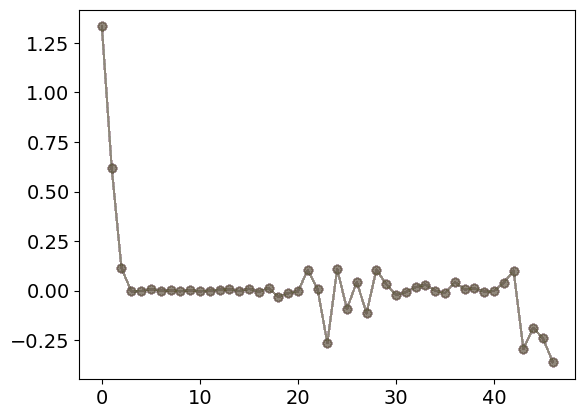

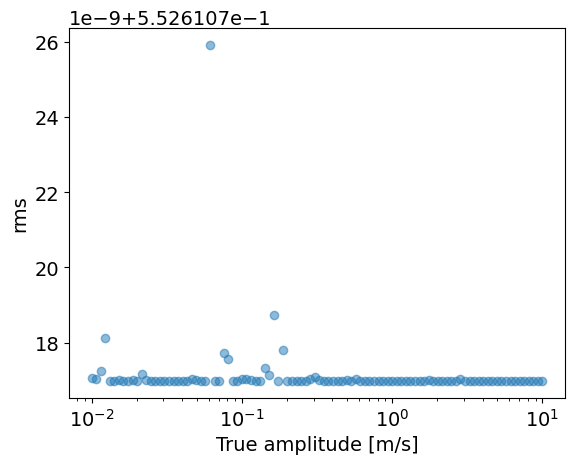

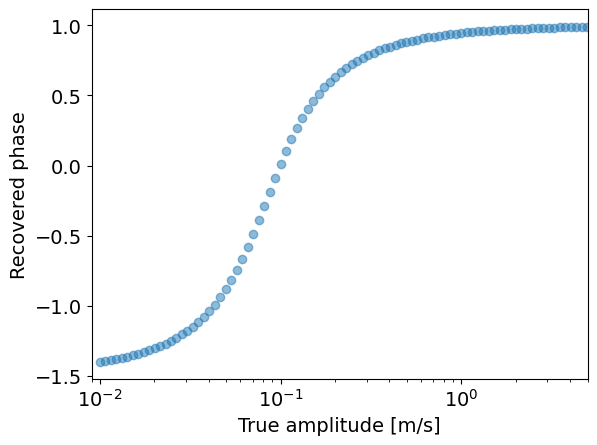

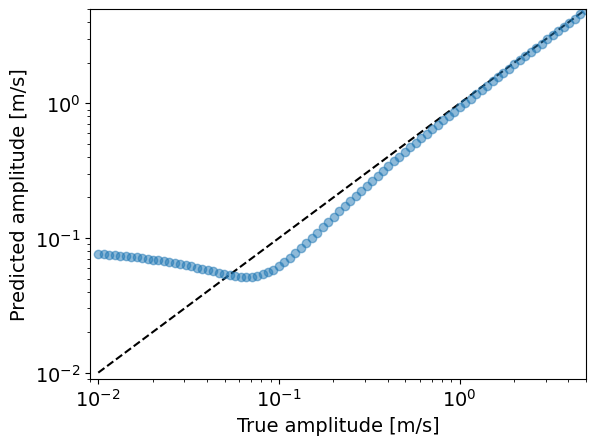

In [481]:
plt.plot(w_array.T, 'o-', alpha=0.01)    
plt.show()

plt.plot(amp, rms_array, 'o', alpha=0.5)
plt.xlabel('True amplitude [m/s]')
plt.ylabel('rms')
plt.xscale('log')
plt.show()

plt.plot(amp, phase_array, 'o', alpha=0.5)
plt.xscale('log')
plt.xlim([0.009, 5])
plt.xlabel('True amplitude [m/s]')
plt.ylabel('Recovered phase')
plt.show()


plt.plot(amp, amp, 'k--')
plt.plot(amp, amp_pred, 'o', alpha=0.5)
plt.xlabel('True amplitude [m/s]')
plt.ylabel('Predicted amplitude [m/s]')
plt.xlim([0.009, 5])
plt.ylim([0.009, 5])
plt.xscale('log')
plt.yscale('log')

### add period 

In [352]:
def loss(params):    
    diff = np.sum(params[:47]*X, axis=1) + params[47] + params[48] * np.sin((t-min(t))*2*np.pi/(10**params[50]) + params[49]) - y
    _, wrms = weighted_avg_and_std(diff, 1/σrv_daily**2)
    return wrms

initial_guess[50] = 1.

y = Y + 2 * np.sin((t-min(t))*2*np.pi/10+1)
result = optimize.minimize(loss, initial_guess, method= "Nelder-Mead")
fitted_params = result.x
print(fitted_params[48:])
print('rms =', loss(fitted_params))

[-1.45034847e-02  1.57691467e-01  7.29465796e+01]
rms = 1.4493846133534662


### using RV_FT_k

In [ ]:
# This custom layer has 2 inputs and 1 output
# First input = the RV prediction from the NN
# Second input = the time of observation, which gets put into the sine function
#It has 1 free parameters, the amplitude of that sine wave

class MakeSine(keras.layers.Layer):

  def __init__(self, units=1):
      super(MakeSine, self).__init__()
      # Units will be number of free parameters for the periodic signal.
      # Here it's just amplitude
      self.units = units

  # Weird bug with input shape here...ignoring it :) 
  def build(self, input_shape): 
    w_init = tf.random_normal_initializer()
    m_init = tf.random_normal_initializer()
    # t_init = tf.random_normal_initializer()
    t_init = tf.random_uniform_initializer(minval=0, maxval=2*np.pi/100)

    self.w = tf.Variable(
        initial_value = w_init(shape=(1, self.units),
                             dtype='float32'), trainable=True)
    self.m = tf.Variable(
        initial_value = w_init(shape=(1, self.units),
                             dtype='float32'), trainable=True)
    self.t = tf.Variable(
        initial_value = t_init(shape=(1, self.units),
                          dtype='float32'), trainable=True)
    
        
  def call(self, input1, input2):
    	#Makes amplitude always positive
        # return input1 + (10.**self.w) * tf.sin(input2)
        return input1 - (10.**self.w) * tf.sin(input2 * 10.**self.m + 100.*self.t)
        # return input1 + (10.**self.w) * tf.sin(input2 + 10.**self.t)
        # return input1 + (10.**self.w) * tf.sin(input2 + 100.*self.t)

# def custom_loss(y_true, y_pred):
#   return K.mean(K.square(y_pred - y_true), axis=-1)

if 1: # use this one 
    def custom_mse(y_test, y_pred):
        squared_difference = tf.dtypes.cast(tf.square((y_test - y_pred)/σrv_daily_test), tf.float64) 
        return tf.dtypes.cast(tf.math.reduce_sum(squared_difference)/tf.math.reduce_sum(tf.square(1/σrv_daily_test)), tf.float64)  # Note the `axis=-1`


In [ ]:
XX = ΔRV_k.T
YY = rv_daily - np.mean(rv_daily)

run = 1
amp = np.logspace(-0, 2, run)
amp_pred = np.zeros(run)
weights = np.zeros((run, RV_FT_k.shape[0]))

for i in range(run):
    y = Y + amp[i] * np.sin(bjd_daily)
    X_train, X_test, y_train, y_test, t_train, t_test, σrv_daily_train, σrv_daily_test = train_test_split(
                                X, y, t, σrv_daily, test_size=0.33, random_state=random.randint(0, 10000))
    model = Model()
    model.compile(loss=custom_loss, optimizer='adam')
    model.fit([X_train,t_train],y_train, epochs=2000, verbose=0)    
       
    weights[i,:] = model.layers[1].get_weights()[0].flatten()
    sine_amp = model.layers[-1].get_weights()[0]
    amp_pred[i] = 10.**sine_amp

In [ ]:
def loss(params):    
    diff = (np.sum(params[:47]*X, axis=1) + params[47] 
            + params[48] * np.sin((t-min(t))*2*np.pi/(1000*params[50])+ params[49]) - y)
    _, wrms = weighted_avg_and_std(diff, 1/σrv_daily**2)
    return wrms

initial_guess = np.zeros(51)
# initial_guess[48] = np.log(np.std(y))
initial_guess[50] = 9.5/1000


from scipy.optimize import basinhopping
from scipy.optimize import shgo

y = Y + 2 * np.sin((t-min(t))*2*np.pi/10+1)
bounds = [(None, None), ]*51
# ret = basinhopping(loss, initial_guess,  niter_success=20, niter=1000)
ret = shgo(loss, bounds)
print(ret.x, ret.fun)

In [304]:
N = 5
amp = np.logspace(-2, 2, N)
amp_pred = np.zeros(N)
w_array = np.zeros((N, 47))
rms_array = np.zeros(N)
phase_array = np.zeros(N)
period_array = np.zeros(N)
initial_guess = np.zeros(51)

def loss(params):    
    diff = np.sum(params[:47]*X, axis=1) + params[47] + params[48] * np.sin(t*params[50] + params[49]) - y
    _, wrms = weighted_avg_and_std(diff, 1/σrv_daily**2)
    return wrms

for i in range(N):
    y = Y + amp[i] * np.sin(t*3+1)

    result = optimize.minimize(loss, initial_guess)
    fitted_params = result.x
    # print(fitted_params)
    # print('rms =', loss(fitted_params))
    w_array[i] = fitted_params[:47]
    amp_pred[i] = fitted_params[48]
    phase_array[i] = fitted_params[49]
    period_array[i] = fitted_params[50]
    rms_array[i] = loss(fitted_params)
    
# plt.plot(fitted_params[:47], 'o-')    

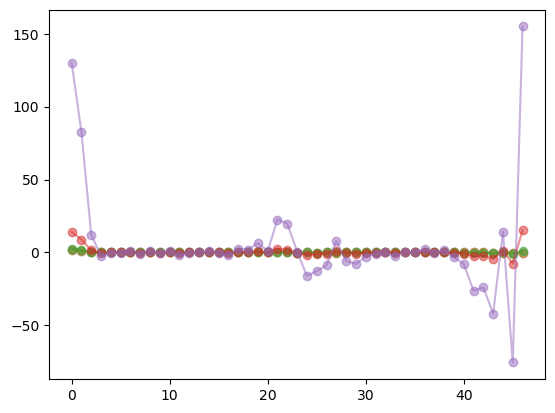

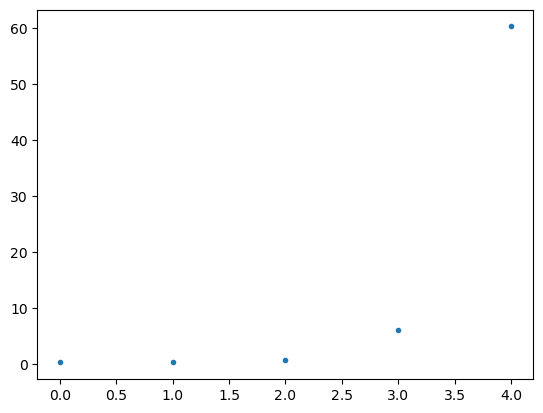

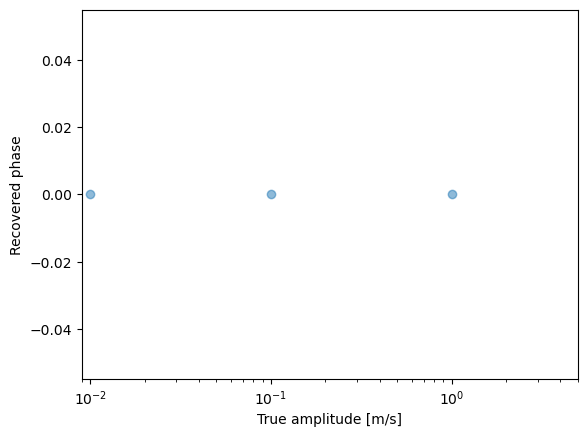

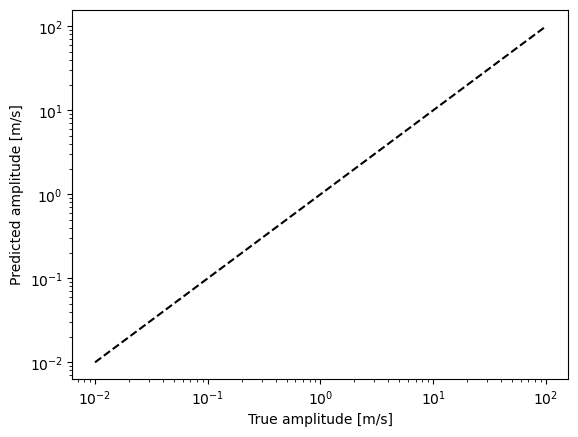

In [300]:
plt.plot(w_array.T, 'o-', alpha=0.5)    
plt.show()

plt.plot(rms_array, '.')
plt.show()

plt.plot(amp, phase_array, 'o', alpha=0.5)
plt.xscale('log')
plt.xlim([0.009, 5])
plt.xlabel('True amplitude [m/s]')
plt.ylabel('Recovered phase')
plt.show()


plt.plot(amp, amp, 'k--')
plt.plot(amp, amp_pred, 'o', alpha=0.5)
plt.xlabel('True amplitude [m/s]')
plt.ylabel('Predicted amplitude [m/s]')
# plt.xlim([0.009, 5])
# plt.ylim([0.009, 5])
plt.xscale('log')
plt.yscale('log')

In [290]:
X = ΔRV_k.T
Y = rv_daily - np.mean(rv_daily) #+ 0.1*np.sin((bjd_daily-min(bjd_daily))*10)
# X = ΔRV_k[:,:150].T
# Y = rv_daily[:150] - np.mean(rv_daily) #+ 0.1*np.sin((bjd_daily-min(bjd_daily))*10)
# Number of features used to predict "RV"
n_feat = X.shape[1]

# Make random signal
# X = your RV features, y = the real RVs, and t = time
y = Y
t = bjd_daily

print(X.shape, y.shape)

# Add sinusoidal to everything
y = y + 0.5 * np.sin(t*3+2)

X_train, X_test, y_train, y_test, t_train, t_test, σrv_daily_train, σrv_daily_test = train_test_split(
    X, y, t, σrv_daily, test_size=0.33, random_state=random.randint(0, 10000))

(202, 47) (202,)


In [291]:
# This custom layer has 2 inputs and 1 output
# First input = the RV prediction from the NN
# Second input = the time of observation, which gets put into the sine function
#It has 1 free parameters, the amplitude of that sine wave

class MakeSine(keras.layers.Layer):

  def __init__(self, units=1):
      super(MakeSine, self).__init__()
      # Units will be number of free parameters for the periodic signal.
      # Here it's just amplitude
      self.units = units

  # Weird bug with input shape here...ignoring it :) 
  def build(self, input_shape): 
    w_init = tf.random_normal_initializer()
    m_init = tf.random_normal_initializer()
    # t_init = tf.random_normal_initializer()
    t_init = tf.random_uniform_initializer(minval=0, maxval=2*np.pi/100)

    self.w = tf.Variable(
        initial_value = w_init(shape=(1, self.units),
                             dtype='float32'), trainable=True)
    self.m = tf.Variable(
        initial_value = w_init(shape=(1, self.units),
                             dtype='float32'), trainable=True)
    self.t = tf.Variable(
        initial_value = t_init(shape=(1, self.units),
                          dtype='float32'), trainable=True)
    
        
  def call(self, input1, input2):
    	#Makes amplitude always positive
        # return input1 + (10.**self.w) * tf.sin(input2)
        return input1 + (10.**self.w) * tf.sin(input2 * 10.**self.m + 100.*self.t)
        # return input1 + (10.**self.w) * tf.sin(input2 + 10.**self.t)
        # return input1 + (10.**self.w) * tf.sin(input2 + 100.*self.t)

# def custom_loss(y_true, y_pred):
#   return K.mean(K.square(y_pred - y_true), axis=-1)

if 1: # use this one 
    def custom_mse(y_test, y_pred):
        squared_difference = tf.dtypes.cast(tf.square((y_test - y_pred)/σrv_daily_test), tf.float64) 
        return tf.dtypes.cast(tf.math.reduce_sum(squared_difference)/tf.math.reduce_sum(tf.square(1/σrv_daily_test)), tf.float64)  # Note the `axis=-1`

if 0:
    def custom_mse(y_test, y_pred):
        # calculating squared difference between target and predicted values 
        loss = K.square( (y_pred - y_test) / σrv_daily_test)  # (batch_size, 2)                    
        # summing both loss values along batch dimension 
        loss = K.sum(loss, axis=-1) / K.sum(K.square(1/σrv_daily_test))        # (batch_size,)
        return loss

In [292]:
def Model():
    # Make the model and make sure the graphs looks right
    from tensorflow.keras import layers

    # So I have 2 inputs: the RV features ("X") and the time of each ("t")
    feat_input = layers.Input(shape=(n_feat,))
    time_input = layers.Input(shape=(1,))

    # The RV goes into the first NN
    # nn1 = layers.Dense(8, activation="relu")(feat_input)
    # nn1 = layers.Dense(1, activation="relu")(nn1)

    nn1 = layers.Dense(1, activation="linear")(feat_input)
    
    # nn1 = layers.Dense(8, activation="relu")(feat_input)
    # nn1 = layers.Dense(1, activation="relu")(nn1)    

    # The second input, t, goes into the sine wave
    # We put the output of the NN into there, to add in the sine wave
    nn2 = MakeSine()(nn1, time_input)

    # So our final model has 2 inputs, 1 output
    model = keras.Model(inputs=[feat_input, time_input], outputs=nn2)
    
    return model

# from keras.utils import plot_model

# plot_model(model)

In [293]:
# I made a custom loss, but it is just MSE! But you should feel free to edit
# the loss as you wish!
model = Model()
model.compile(loss=custom_mse, optimizer='adam')
lr_model_history = model.fit([X_train,t_train],y_train, epochs=5000, verbose=0, validation_data=([X_test,t_test], y_test))

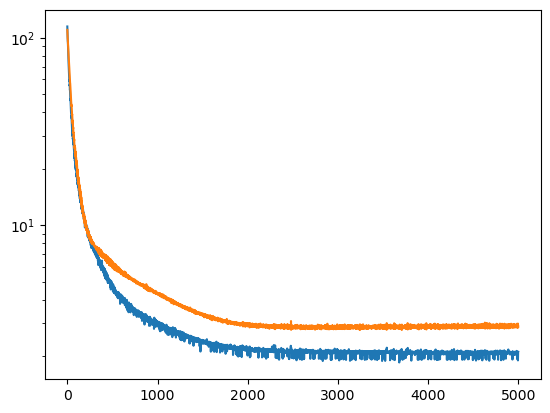

In [294]:
lr_model_history.history.keys()
plt.plot(np.array(lr_model_history.history['loss'])**0.5)
plt.plot(np.array(lr_model_history.history['val_loss'])**0.5)
plt.yscale('log')

3/3 [==============================] - 0s 1ms/step
(67,) (67, 1)


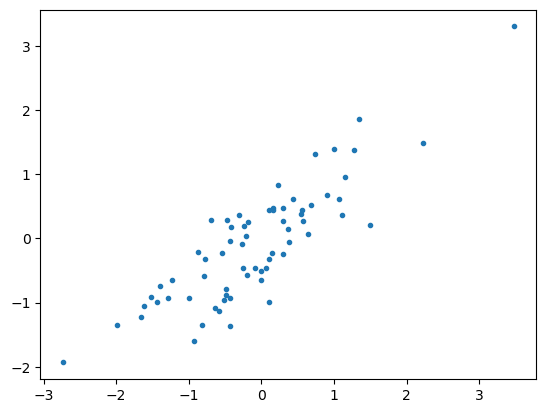

(-0.0844437246240482, 0.5073193454244951)

In [295]:
# predictions = model.predict([ΔRV_k[:,150:].T,bjd_daily[150:]])
predictions = model.predict([X_test,t_test])
print(np.shape(y_test), np.shape(predictions))
# plt.plot(rv_daily[150:] - np.mean(rv_daily), predictions,'.')
plt.plot(y_test, predictions,'.')
plt.show()
weighted_avg_and_std(predictions[:,0]-y_test, weights=1/σrv_daily_test**2)

In [296]:
# This is the final amp prediction!
para = np.asarray(model.layers[-1].get_weights())
print(10.**para)
print(100.*para)

[[[0.00405247]]

 [[1.2694674 ]]

 [[1.2662119 ]]]
[[[-239.22798 ]]

 [[  10.362153]]

 [[  10.250636]]]


In [ ]:
lr_model_history.history.keys()
plt.plot(lr_model_history.history['loss'])
plt.plot(lr_model_history.history['val_loss'])
plt.yscale('log')

In [ ]:
lr_model_history.history['loss'][-1]**0.5, lr_model_history.history['val_loss'][-1]**0.5

In [ ]:
predictions = model.predict([X_test,t_test])
print(np.shape(y_test), np.shape(predictions))
plt.plot(y_test,predictions,'.')
plt.show()
weighted_avg_and_std(predictions[:,0]-y_test, weights=1/σrv_daily_test**2)

In [ ]:
plt.plot(model.layers[1].get_weights()[0], 'o-')

In [ ]:
plt.plot(bjd_daily, weighted_avg_2D(X, weights=model.layers[1].get_weights()[0].flatten()), 'r.', label='weighted average (prediction)')
plt.plot(bjd_daily, Y, 'b.', label='RV_daily')
# plt.xlim([min(bjd_daily), max(bjd_daily) ])
plt.legend()
plt.show()

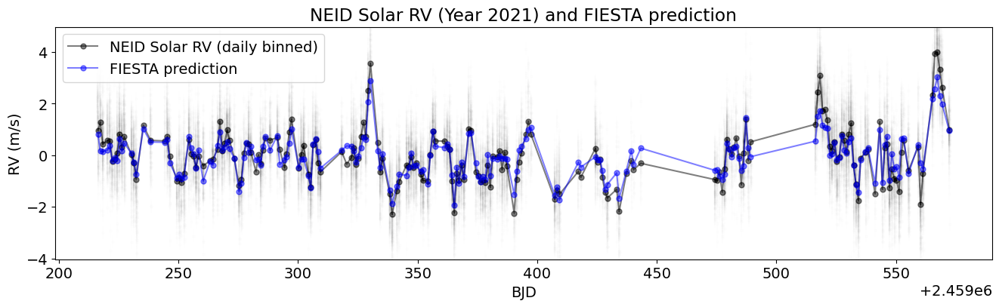

In [409]:
plt.rcParams['font.size'] = '14'

fig = plt.figure(figsize=(16, 4))
plt.errorbar(bjd, rv-np.mean(rv_daily), σrv, marker='.', ms=5, color='black', ls='none', alpha=0.005)
plt.plot(bjd_daily, rv_daily-np.mean(rv_daily), marker='.', ms=10, color='black', ls='-', alpha=0.5, label='NEID Solar RV (daily binned)')
plt.plot(bjd_daily, weighted_avg_2D(X, weights=model.layers[1].get_weights()[0].flatten()), marker='.', ms=10, color='blue', ls='-', alpha=0.5, label='FIESTA prediction')
plt.ylim([np.median(rv-np.mean(rv_daily))-4, np.median(rv-np.mean(rv_daily))+5])
plt.title('NEID Solar RV (Year 2021) and FIESTA prediction')
plt.xlabel('BJD')
plt.ylabel('RV (m/s)')
plt.legend(loc=2)
# plt.savefig('../Figures/Postdoc application/NEID Solar RV (Year 2021) and FIESTA prediction.png')
plt.show()

In [ ]:
plt.rcParams['font.size'] = '14'

fig = plt.figure(figsize=(16, 4))
plt.errorbar(bjd, rv-np.mean(rv_daily), σrv, marker='.', ms=5, color='black', ls='none', alpha=0.005)
plt.plot(bjd_daily, rv_daily-np.mean(rv_daily), marker='.', ms=10, color='black', ls='-', alpha=0.5, label='NEID Solar RV (daily binned)')
plt.plot(bjd_daily, weighted_avg_2D(X, weights=model.layers[1].get_weights()[0].flatten()), marker='.', ms=10, color='blue', ls='-', alpha=0.5, label='FIESTA prediction')
plt.ylim([np.median(rv-np.mean(rv_daily))-4, np.median(rv-np.mean(rv_daily))+5])
plt.title('NEID Solar RV (Year 2021) and FIESTA prediction')
plt.xlabel('BJD')
plt.ylabel('RV (m/s)')
plt.legend(loc=2)
plt.savefig('../Figures/Postdoc application/NEID Solar RV (Year 2021) and FIESTA prediction.png')
plt.show()

## Inject planet amplitudes from 0.01 to 100 m/s

In [ ]:
X = ΔRV_k.T
Y = rv_daily - np.mean(rv_daily)

run = 100
amp = np.logspace(-2, 2, run)
amp_pred = np.zeros(run)
weights = np.zeros((run, RV_FT_k.shape[0]))

for i in range(run):
    y = Y + amp[i] * np.sin(bjd_daily)
    X_train, X_test, y_train, y_test, t_train, t_test, σrv_daily_train, σrv_daily_test = train_test_split(
                                X, y, t, σrv_daily, test_size=0.33, random_state=random.randint(0, 10000))
    model = Model()
    model.compile(loss=custom_loss, optimizer='adam')
    model.fit([X_train,t_train],y_train, epochs=2000, verbose=0)    
       
    weights[i,:] = model.layers[1].get_weights()[0].flatten()
    sine_amp = model.layers[-1].get_weights()[0]
    amp_pred[i] = 10.**sine_amp

In [ ]:
np.mean(σrv_daily)

In [ ]:
fig = plt.figure(figsize=(8, 6))
plt.plot(amp, amp, 'k--')
plt.plot(amp, amp_pred, 'o', alpha=0.5)
plt.xlabel('True amplitude [m/s]')
plt.ylabel('Predicted amplitude [m/s]')
plt.xlim([0.009, 5])
plt.ylim([0.009, 5])
plt.xscale('log')
plt.yscale('log')
plt.savefig('../Figures/Postdoc application/planet recovery.png')
plt.show()

## 0 m/s planet amplitudes test

In [ ]:
X = ΔRV_k.T
Y = rv_daily - np.mean(rv_daily)

run = 100
# amp = np.linspace(0.1, 5, run)
amp_pred = np.zeros(run)
weights = np.zeros((run, RV_FT_k.shape[0]))

for i in range(run):
    y = Y 
    X_train, X_test, y_train, y_test, t_train, t_test, σrv_daily_train, σrv_daily_test = train_test_split(
                                X, y, t, σrv_daily, test_size=0.33, random_state=random.randint(0, 10000))    
    model = Model()
    model.compile(loss=custom_loss, optimizer='adam')
    model.fit([X_train,t_train],y_train, epochs=2000, verbose=0) 
       
    weights[i,:] = model.layers[1].get_weights()[0].flatten()
    sine_amp = model.layers[-1].get_weights()[0]
    amp_pred[i] = 10.**sine_amp

In [ ]:
# plt.plot(amp, amp, '-')
plt.plot(amp_pred, 'o')
plt.xlabel('Run')
plt.ylabel('Predicted amplitude [m/s]')
plt.yscale('log')
plt.show()

In [ ]:
np.std(amp_pred)

In [ ]:
plt.plot((weights.T), 'o-', alpha=0.1)
plt.plot((np.median(weights,axis=0).T), 'ko-', alpha=1)
plt.xlabel('mode')
plt.ylabel('weights')
plt.show()    

In [ ]:
# plt.plot(weights[:,0], weights[:,1], '.')

# Train-test split on the NEID solar data by trunks

In [ ]:
X = ΔRV_k.T
Y = rv_daily - np.mean(rv_daily) #+ 0.1*np.sin((bjd_daily-min(bjd_daily))*10)
print(X.shape, Y.shape)

input_dim = X.shape[1]
lr_model = Sequential()
lr_model.add(Dense(1, activation=tf.keras.activations.linear, kernel_initializer='uniform', 
                input_dim = input_dim))

for i in range(4):
    kk = i+1
    _, y_test, y_pred, σrv_test, bjd_test, std = model_MLP(X, Y, bjd_daily, σrv_daily, lr_model, epochs=2500, learning_rate=1e-3, kk=kk)

    fig = plt.figure(figsize=(16, 4))
    plt.plot(bjd_test, y_pred, 'o', markersize=5, label='res wrms = {0:.2f} m/s'.format(std))
    plt.plot(bjd_daily, Y, 'o', alpha=0.4, label=r'$RV_{NEID}$')
    plt.title('NEID Solar RV 2021')
    plt.xlabel('BJD')
    plt.ylabel('RV (m/s)')
    plt.legend()
    plt.show()

In [ ]:
X = ΔRV_k.T
Y = rv_daily - np.mean(rv_daily) 
print(X.shape, Y.shape)

input_dim = X.shape[1]
lr_model = Sequential()
lr_model.add(Dense(1, activation=tf.keras.activations.linear, kernel_initializer='uniform', 
                input_dim = input_dim))

for i in range(4):
    kk = i+1
    _, y_test, y_pred, σrv_test, bjd_test, std = model_MLP(X, Y, bjd_daily, σrv_daily, lr_model, epochs=1500, learning_rate=1e-3, kk=kk)

    fig = plt.figure(figsize=(16, 4))
    plt.plot(bjd_test, y_pred, 'o', markersize=5, label='res wrms = {0:.2f} m/s'.format(std))
    plt.plot(bjd_daily, Y, 'o', alpha=0.4, label=r'$RV_{NEID}$')
    plt.title('NEID Solar RV 2021')
    plt.xlabel('BJD')
    plt.ylabel('RV (m/s)')
    plt.legend()
    plt.show()

In [ ]:
lr_model_history.history.keys()

In [ ]:
# lr_model_history.history['loss']
fig, ax = plt.subplots(1, 1)
ax.plot(np.sqrt(lr_model_history.history['custom_mse']), 'b', label='train')    
ax.plot(np.sqrt(lr_model_history.history['val_custom_mse']), 'r' ,label='test')
# ax.plot(np.sqrt(lr_model_history.history['loss']), 'b', label='train_loss')    

ax.set_xlabel(r'Epoch')
ax.set_ylabel(r'wmse')
# ax.set_yscale('log')
ax.legend()
ax.tick_params(labelsize=20)
ax.grid()
# ax.set_xlim([20, epochs])
# ax.set_ylim([0, 2])
plt.show()


In [ ]:
RMS = np.zeros(101)
AMP = np.linspace(-5,5,101)
for i in range(101):
    Y = rv_daily - np.mean(rv_daily) + AMP[i]*np.sin((bjd_daily-min(bjd_daily))*10)
    input_dim = X.shape[1]
    lr_model = Sequential()
    lr_model.add(Dense(16, activation=tf.keras.activations.linear, kernel_initializer='uniform', 
                    input_dim = input_dim)) 
    lr_model.add(Dense(1, kernel_initializer='uniform', activation=tf.keras.activations.linear))
    lr_model, y_test, y_pred, σrv_test, bjd_test, std = model_MLP(X, Y, bjd_daily, σrv_daily, lr_model, epochs=2000, learning_rate=5e-4)
    RMS[i] = std

In [ ]:
plt.plot(AMP, RMS)
plt.xlabel('amplitude')
plt.ylabel('rms')
plt.show()

wrms = 0.27

In [ ]:
y_test2, y_pred2, σrv_test2, bjd_test2 = y_test, y_pred, σrv_test, bjd_test

wrms = 0.287

In [ ]:
y_test1, y_pred1, σrv_test1, bjd_test1 = y_test, y_pred, σrv_test, bjd_test

wrms = 0.365

In [ ]:
y_test3, y_pred3, σrv_test3, bjd_test3 = y_test, y_pred, σrv_test, bjd_test

wrms = 0.500

In [ ]:
y_test4, y_pred4, σrv_test4, bjd_test4 = y_test, y_pred, σrv_test, bjd_test

In [ ]:
fig = plt.figure(figsize=(16, 4))
plt.plot(bjd_test1, y_pred1, 'o', markersize=5, label='wrms = 0.29 m/s')
plt.plot(bjd_test2, y_pred2, 'o', markersize=5, label='wrms = 0.27 m/s')
plt.plot(bjd_test3, y_pred3, 'o', markersize=5, label='wrms = 0.37 m/s')
plt.plot(bjd_test4, y_pred4, 'o', markersize=5, label='wrms = 0.50 m/s')
plt.plot(bjd_daily, np.hstack((y_test1, y_test2, y_test3, y_test4)), 'o', alpha=0.4, label=r'$RV_{NEID}$')
plt.title('NEID Solar RV 2021')
plt.xlabel('BJD')
plt.ylabel('RV (m/s)')
plt.legend()
plt.show()

# Try other NN configurations

In [ ]:
X = ΔRV_k.T[:,0:23]
# X = ΔRV_k.T
Y = rv_daily - np.mean(rv_daily)
print(X.shape, Y.shape)
###################
# build the model #
###################
input_dim = X.shape[1]
lr_model = Sequential()
# lr_model.add(Dense(32, activation=tf.nn.relu, kernel_initializer='uniform', 
#                 input_dim = input_dim)) 
# lr_model.add(Dense(16, kernel_initializer='uniform', activation=tf.nn.relu))
lr_model.add(Dense(16, activation=tf.keras.activations.linear, kernel_initializer='uniform', 
                input_dim = input_dim)) # add bias term!
# lr_model.add(Dense(20, kernel_initializer='uniform', activation=tf.nn.relu))
# lr_model.add(Dense(20, kernel_initializer='uniform', activation=tf.nn.relu))
# lr_model.add(Dense(20, kernel_initializer='uniform', activation=tf.nn.tanh))
lr_model.add(Dense(1, kernel_initializer='uniform', activation=tf.keras.activations.linear))

y_test, y_pred = model_MLP(X, Y, lr_model, epochs=10000, learning_rate=1e-3)

In [ ]:
# X = ΔRV_k.T[:,0:10]
X = RV_FT_k.T
Y = rv_daily - np.mean(rv_daily)
print(X.shape, Y.shape)
###################
# build the model #
###################
input_dim = X.shape[1]
lr_model = Sequential()
# lr_model.add(Dense(32, activation=tf.nn.relu, kernel_initializer='uniform', 
#                 input_dim = input_dim)) 
# lr_model.add(Dense(16, kernel_initializer='uniform', activation=tf.nn.relu))
lr_model.add(Dense(16, activation=tf.keras.activations.linear, kernel_initializer='uniform', 
                input_dim = input_dim)) # add bias term!
# lr_model.add(Dense(20, kernel_initializer='uniform', activation=tf.nn.relu))
# lr_model.add(Dense(20, kernel_initializer='uniform', activation=tf.nn.relu))
# lr_model.add(Dense(20, kernel_initializer='uniform', activation=tf.nn.tanh))
lr_model.add(Dense(1, kernel_initializer='uniform', activation=tf.keras.activations.linear))

y_test, y_pred = model_MLP(X, Y, lr_model, epochs=10000, learning_rate=1e-3)

In [ ]:
lr_model = Sequential()
lr_model.add(Dense(16, kernel_initializer='uniform', activation=tf.nn.relu))
# lr_model.add(Dense(16, kernel_initializer='uniform', activation=tf.nn.relu))
# lr_model.add(Dense(16, kernel_initializer='uniform', activation=tf.nn.relu))
lr_model.add(Dense(1, kernel_initializer='uniform', activation=tf.keras.activations.linear))

y_test, y_pred = model_MLP(X, Y, lr_model, epochs=5000, learning_rate=1e-3)

In [ ]:
# X = ΔRV_k.T[:,0:10]
X = ΔRV_k.T
Y = rv_daily - np.mean(rv_daily)
print(X.shape, Y.shape)
###################
# build the model #
###################
input_dim = X.shape[1]
lr_model = Sequential()
# lr_model.add(Dense(32, activation=tf.nn.relu, kernel_initializer='uniform', 
#                 input_dim = input_dim)) 
# lr_model.add(Dense(16, kernel_initializer='uniform', activation=tf.nn.relu))
lr_model.add(Dense(40, activation=tf.keras.activations.linear, kernel_initializer='uniform', 
                input_dim = input_dim)) # add bias term!
# lr_model.add(Dense(20, kernel_initializer='uniform', activation=tf.nn.relu))
# lr_model.add(Dense(20, kernel_initializer='uniform', activation=tf.nn.tanh))
lr_model.add(Dense(1, kernel_initializer='uniform', activation=tf.keras.activations.linear))

y_test, y_pred = model_MLP(X, Y, lr_model, epochs=500, learning_rate=1e-3)

In [ ]:
# X = ΔRV_k.T[:,0:10]
X = ΔRV_k.T
Y = rv_daily - np.mean(rv_daily)
print(X.shape, Y.shape)
###################
# build the model #
###################
input_dim = X.shape[1]
lr_model = Sequential()
# lr_model.add(Dense(32, activation=tf.nn.relu, kernel_initializer='uniform', 
#                 input_dim = input_dim)) 
# lr_model.add(Dense(16, kernel_initializer='uniform', activation=tf.nn.relu))
lr_model.add(Dense(16, activation=tf.keras.activations.linear, kernel_initializer='uniform', 
                input_dim = input_dim)) # add bias tern!
# lr_model.add(Dropout(0.1))
# lr_model.add(Dense(40, kernel_initializer='uniform', activation=tf.nn.relu))
# lr_model.add(Dense(20, kernel_initializer='uniform', activation=tf.nn.relu))
# lr_model.add(Dense(4, kernel_initializer='uniform', activation=tf.nn.relu))
lr_model.add(Dense(20, kernel_initializer='uniform', activation=tf.nn.tanh))
lr_model.add(Dense(1, kernel_initializer='uniform', activation=tf.keras.activations.linear))

y_test, y_pred = model_MLP(X, Y, lr_model, epochs=1000, learning_rate=1e-3)



In [ ]:
X = ΔRV_k.T[:,0:30]
# X = ΔRV_k.T
Y = rv_daily - np.mean(rv_daily)
print(X.shape, Y.shape)
###################
# build the model #
###################
input_dim = X.shape[1]
lr_model = Sequential()
# lr_model.add(Dense(32, activation=tf.nn.relu, kernel_initializer='uniform', 
#                 input_dim = input_dim)) 
# lr_model.add(Dense(16, kernel_initializer='uniform', activation=tf.nn.relu))
lr_model.add(Dense(16, activation=tf.keras.activations.linear, kernel_initializer='uniform', 
                input_dim = input_dim)) # add bias term!
# lr_model.add(Dense(20, kernel_initializer='uniform', activation=tf.nn.relu))
# lr_model.add(Dense(20, kernel_initializer='uniform', activation=tf.nn.tanh))
lr_model.add(Dense(1, kernel_initializer='uniform', activation=tf.keras.activations.linear))

y_test, y_pred = model_MLP(X, Y, lr_model,  epochs=500, learning_rate=1e-3)

In [ ]:
X = CCF_daily.T
Y = rv_daily - np.mean(rv_daily)
print(X.shape, Y.shape)
###################
# build the model #
###################
# lr_model = Sequential()
# lr_model.add(Dense(1, kernel_initializer='uniform', activation=tf.keras.activations.linear))
lr_model, y_test, y_pred, σrv_test, bjd_test, std  = model_MLP(X, Y, bjd_daily, σrv_daily, lr_model, epochs=10000, learning_rate=1e-4)

# y_test, y_pred = model_MLP(X, Y, lr_model,  epochs=50000, learning_rate=5e-3)